In [1]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.


[master 53e34bae] From Mac
 4 files changed, 7660 insertions(+), 16 deletions(-)
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/9a swiss roll-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/9a swiss roll.ipynb


To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   1bbb2d0d..53e34bae  master -> master


In [2]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [3]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


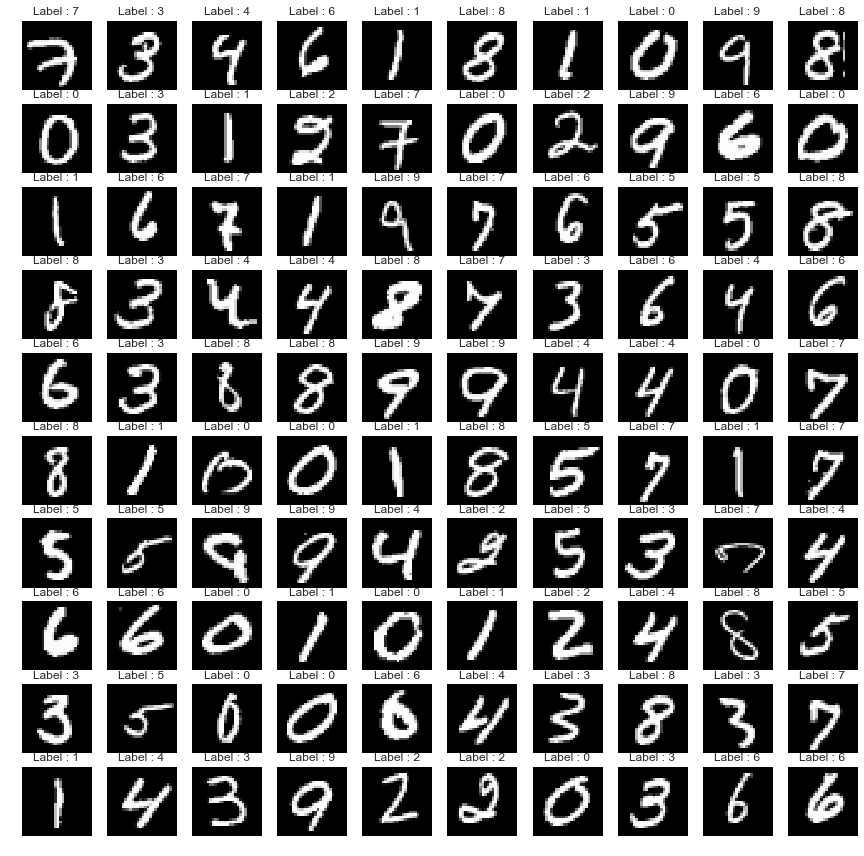

In [4]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [5]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [6]:
# hyper class
num_epoch = 101; batch_size = 100; print_size = 1; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

aimed_range = tf.placeholder(shape=[],dtype=tf.float32)

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

# 0.00005
def norm_vec(x,aimed_range):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (aimed_range + aimed_range) - aimed_range

In [7]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_,aimed_range)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3,aimed_range)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2,aimed_range)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1,aimed_range)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3,aimed_range)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2,aimed_range)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [8]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [9]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [10]:
# 3. update the generator here 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(norm_vec(fake_disgrad1,aimed_range)+fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(norm_vec(fake_egrad3,aimed_range)+fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(norm_vec(fake_egrad2,aimed_range)+fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

 iter: 0 batch: 19900 range: 5e-05 recon cost: 0.28450552 zero cost: 0.0059927953								 one  cost: 0.029366082 fake cost: 7.1436067

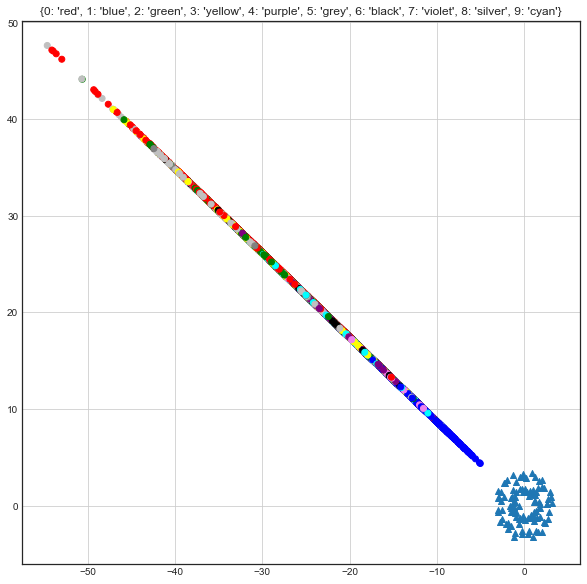

 iter: 1 batch: 19900 range: 4.5e-05 recon cost: 0.26261258 zero cost: 0.0030738171								 one  cost: 0.0076331603 fake cost: 8.2992595

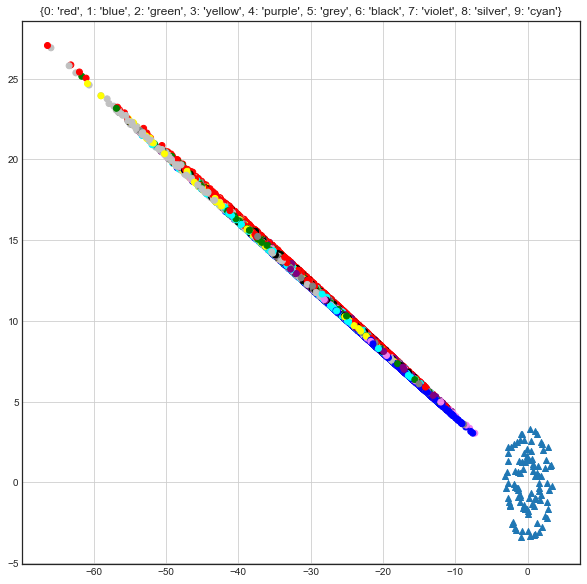

 iter: 2 batch: 19900 range: 4.05e-05 recon cost: 0.25648317 zero cost: 0.0031755911								 one  cost: 0.0039655874 fake cost: 9.180874765

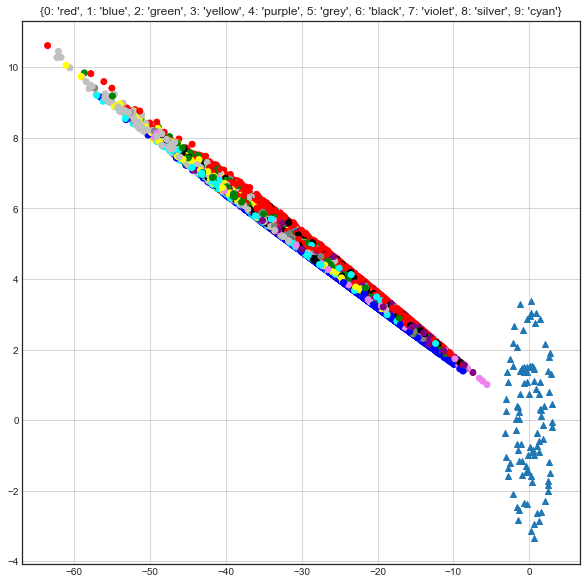

 iter: 3 batch: 19900 range: 3.6450000000000005e-05 recon cost: 0.25313416 zero cost: 0.006537615								 one  cost: 0.002796233 fake cost: 10.2922943585

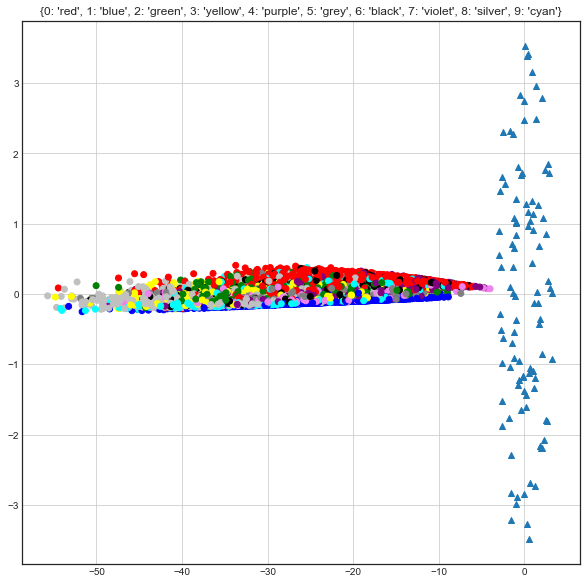

 iter: 4 batch: 19900 range: 3.280500000000001e-05 recon cost: 0.2505732 zero cost: 0.011926842								 one  cost: 0.0021122813 fake cost: 12.0467444485

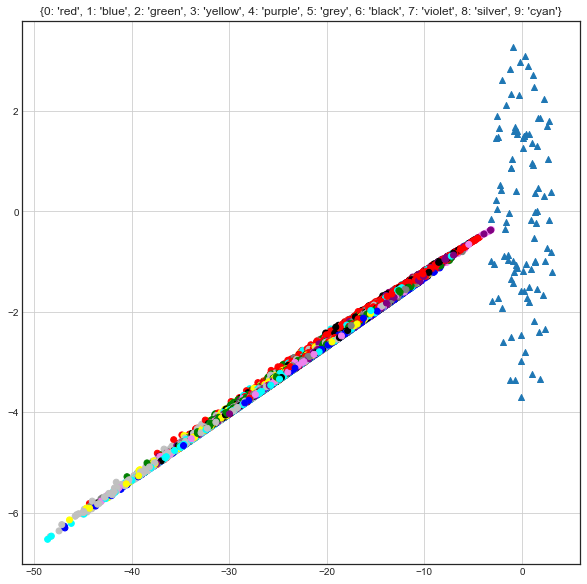

 iter: 5 batch: 19900 range: 2.952450000000001e-05 recon cost: 0.24790627 zero cost: 0.020529397								 one  cost: 0.0018257546 fake cost: 13.557147515

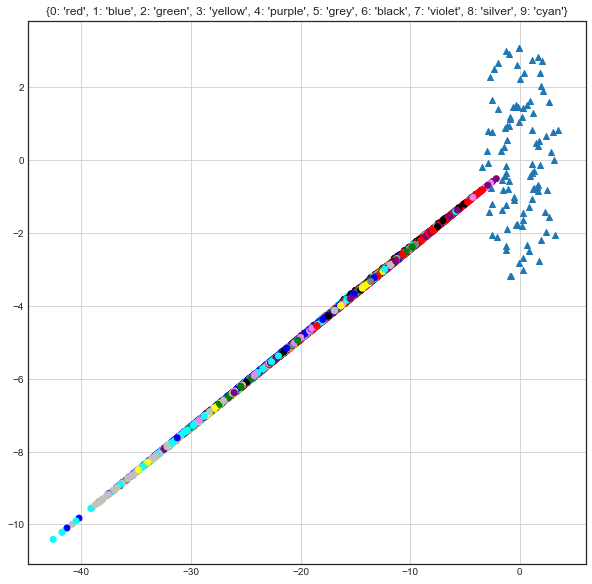

 iter: 6 batch: 19900 range: 2.657205000000001e-05 recon cost: 0.24533811 zero cost: 0.035779405								 one  cost: 0.002668266 fake cost: 14.2550328895

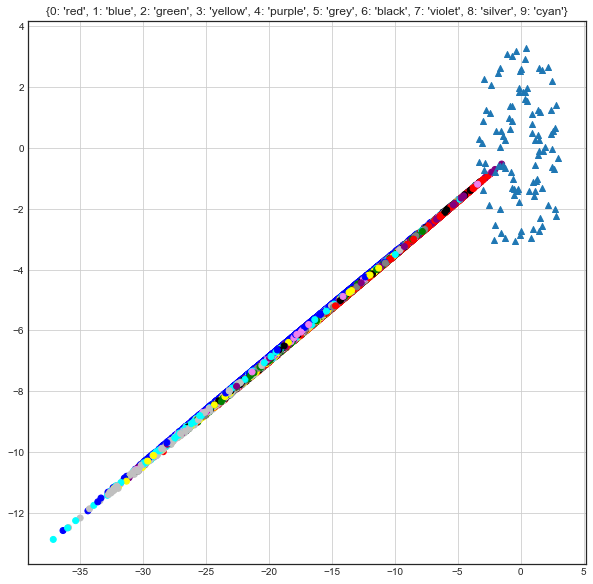

 iter: 7 batch: 19900 range: 2.391484500000001e-05 recon cost: 0.2431668 zero cost: 0.058188163								 one  cost: 0.0065125064 fake cost: 14.190774971

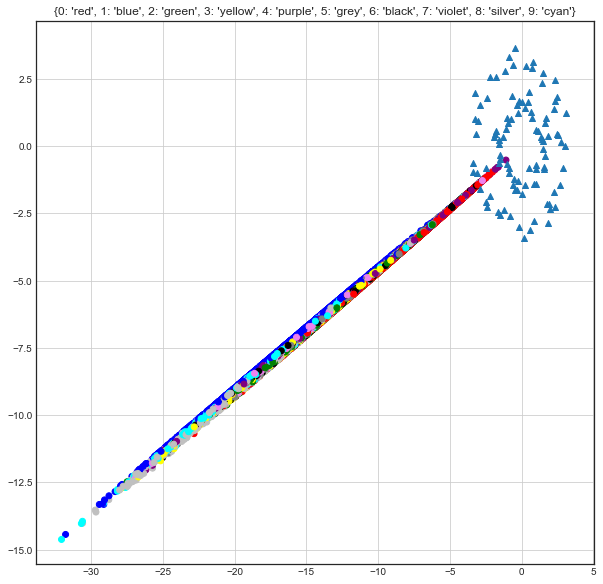

 iter: 8 batch: 19900 range: 2.152336050000001e-05 recon cost: 0.241363 zero cost: 0.08650081								 one  cost: 0.0035312881 fake cost: 13.31649759445

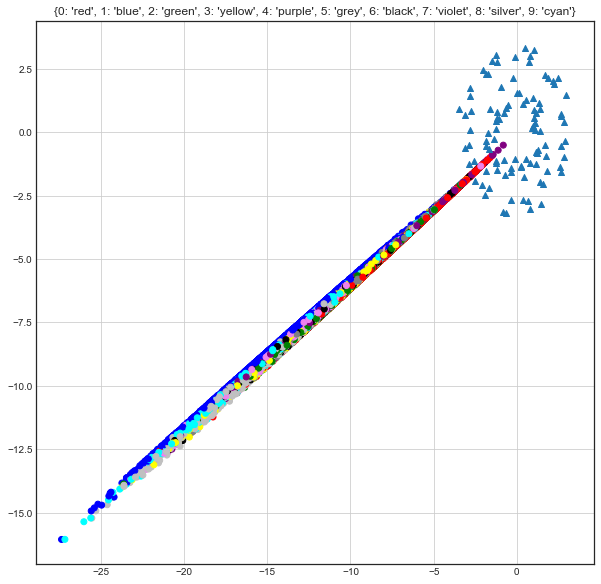

 iter: 9 batch: 19900 range: 1.937102445000001e-05 recon cost: 0.23964338 zero cost: 0.10671659								 one  cost: 0.010823774 fake cost: 12.667156213

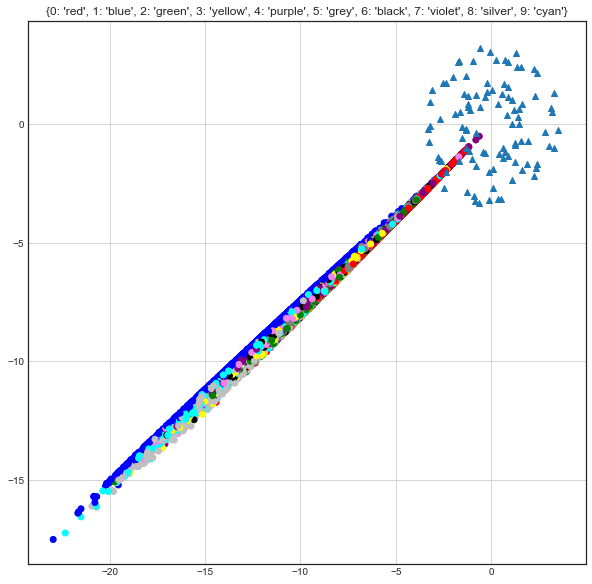

 iter: 10 batch: 19900 range: 1.7433922005000008e-05 recon cost: 0.23803723 zero cost: 0.12703703								 one  cost: 0.021018755 fake cost: 11.684484841

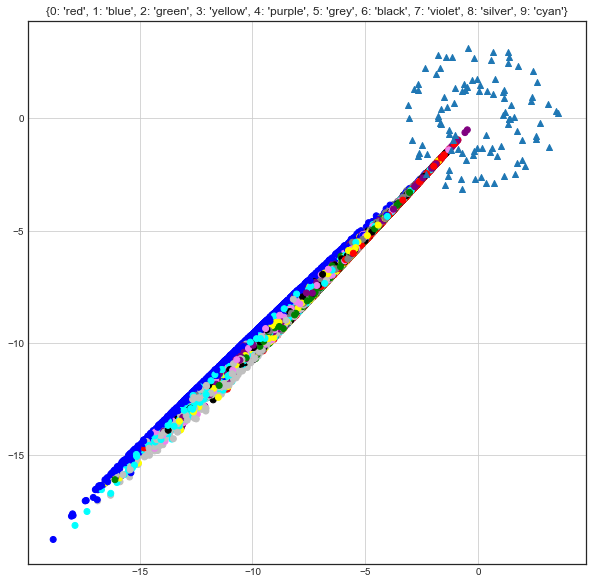

 iter: 11 batch: 19900 range: 1.569052980450001e-05 recon cost: 0.23658688 zero cost: 0.13029219								 one  cost: 0.01873712 fake cost: 10.7824745615

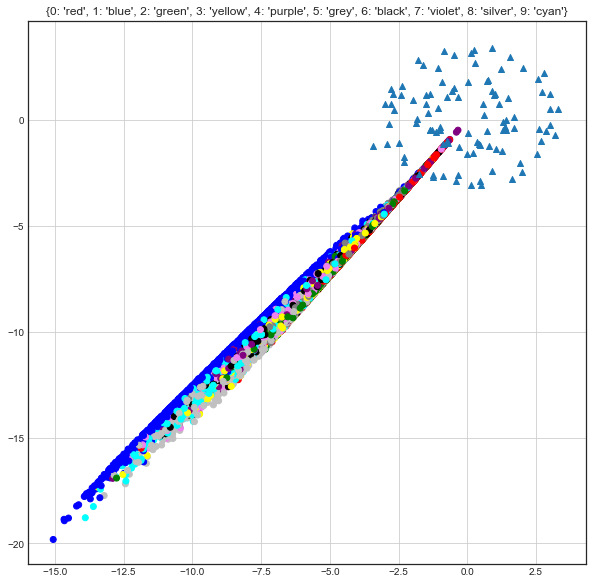

 iter: 12 batch: 19900 range: 1.4121476824050009e-05 recon cost: 0.23527698 zero cost: 0.12961894								 one  cost: 0.012300244 fake cost: 9.678411552

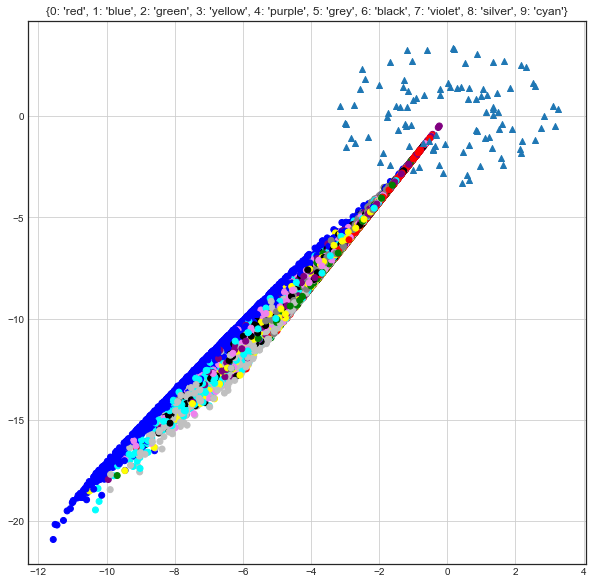

 iter: 13 batch: 19900 range: 1.2709329141645008e-05 recon cost: 0.23413649 zero cost: 0.12267079								 one  cost: 0.028816503 fake cost: 8.965629253

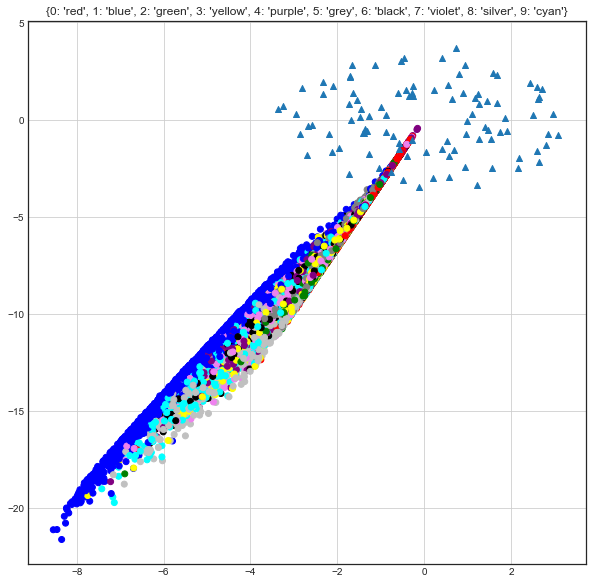

 iter: 14 batch: 19900 range: 1.1438396227480508e-05 recon cost: 0.23322368 zero cost: 0.10731184								 one  cost: 0.04931542 fake cost: 8.348760636

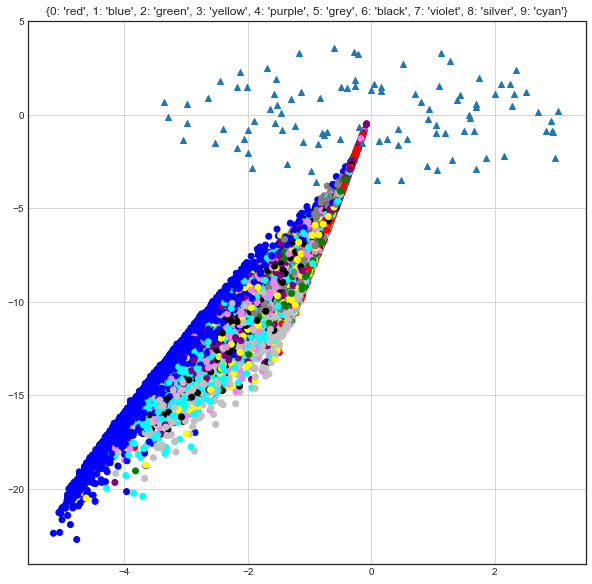

 iter: 15 batch: 19900 range: 1.0294556604732457e-05 recon cost: 0.2325511 zero cost: 0.093723476								 one  cost: 0.042078704 fake cost: 8.11899897

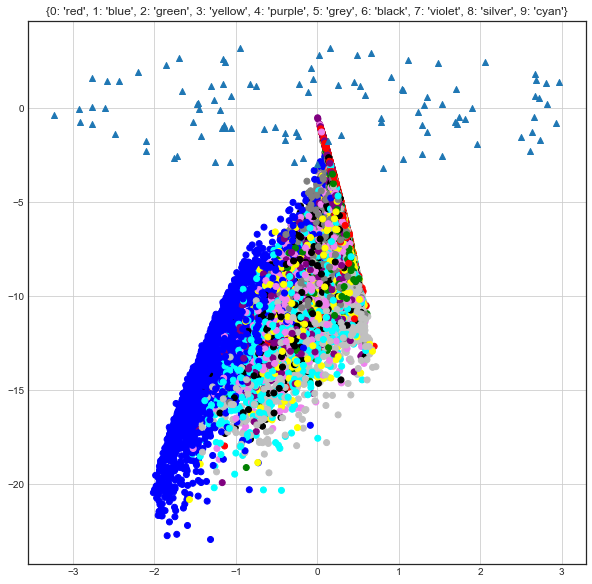

 iter: 16 batch: 19900 range: 9.265100944259211e-06 recon cost: 0.23175116 zero cost: 0.091417074								 one  cost: 0.052681547 fake cost: 7.9604883

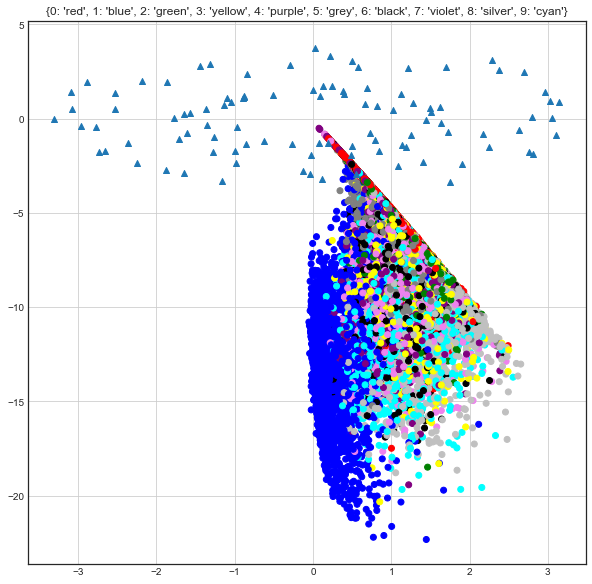

 iter: 17 batch: 19900 range: 8.33859084983329e-06 recon cost: 0.23078045 zero cost: 0.0961301								 one  cost: 0.029084258 fake cost: 7.915683935

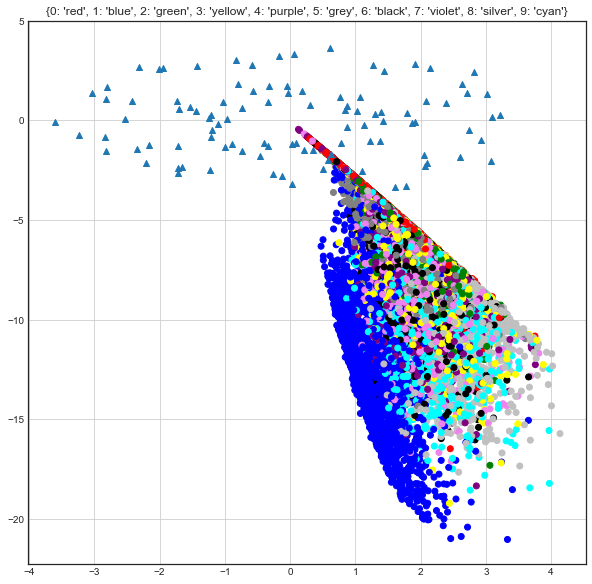

 iter: 18 batch: 19900 range: 7.504731764849961e-06 recon cost: 0.2296289 zero cost: 0.1045567								 one  cost: 0.077960014 fake cost: 7.9126005597

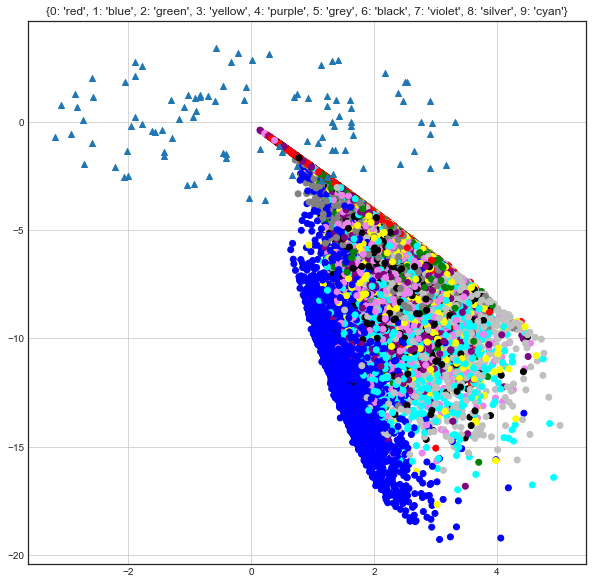

 iter: 19 batch: 19900 range: 6.754258588364965e-06 recon cost: 0.22797187 zero cost: 0.13712084								 one  cost: 0.067212306 fake cost: 5.59375675

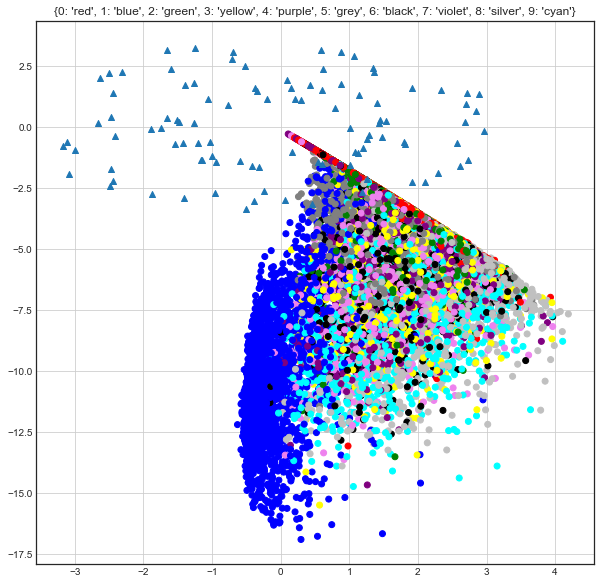

 iter: 20 batch: 19900 range: 6.078832729528469e-06 recon cost: 0.22624771 zero cost: 0.318981								 one  cost: 0.34925443 fake cost: 3.2379723164

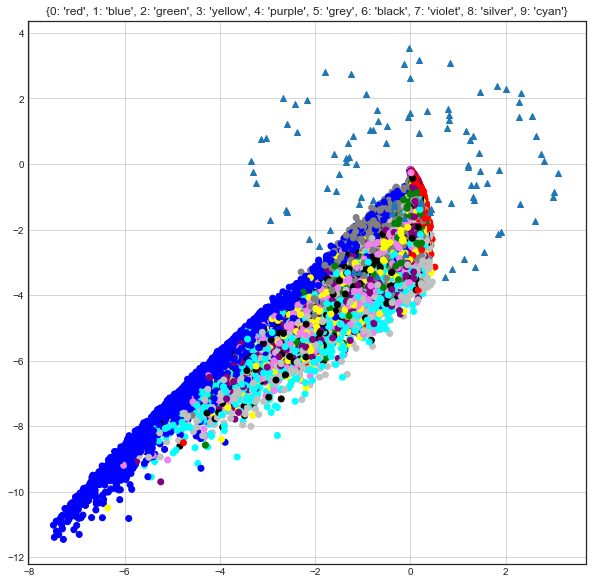

 iter: 21 batch: 19900 range: 5.470949456575622e-06 recon cost: 0.22532862 zero cost: 0.2800335								 one  cost: 0.5247931 fake cost: 2.266302694

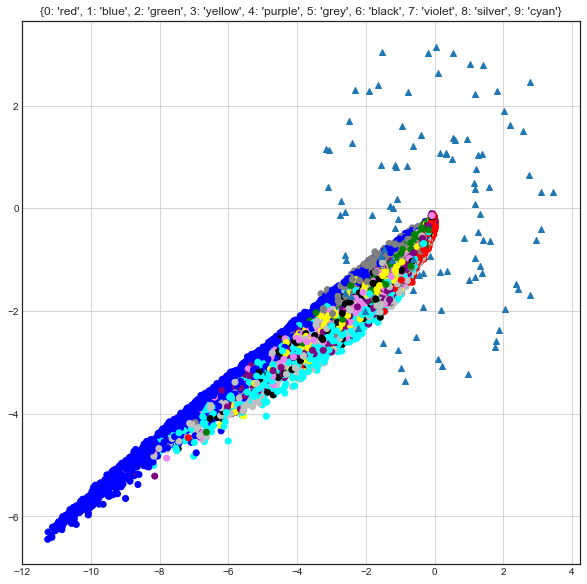

 iter: 22 batch: 19900 range: 4.92385451091806e-06 recon cost: 0.2247883 zero cost: 0.21919619								 one  cost: 0.43599474 fake cost: 2.04672274

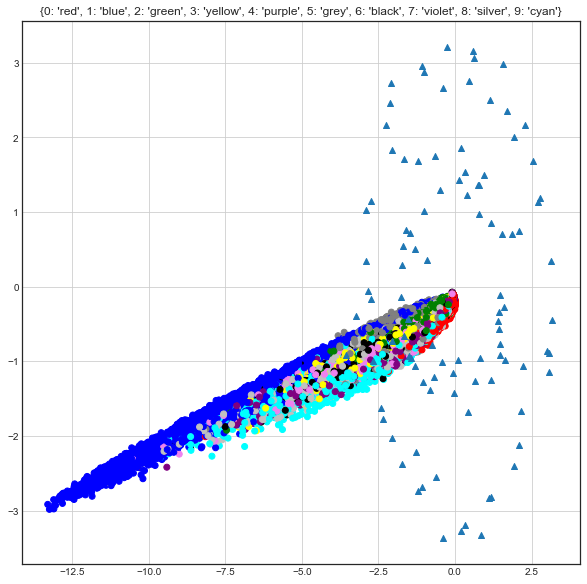

 iter: 23 batch: 19900 range: 4.431469059826254e-06 recon cost: 0.22436969 zero cost: 0.18054344								 one  cost: 0.29184768 fake cost: 2.1099778

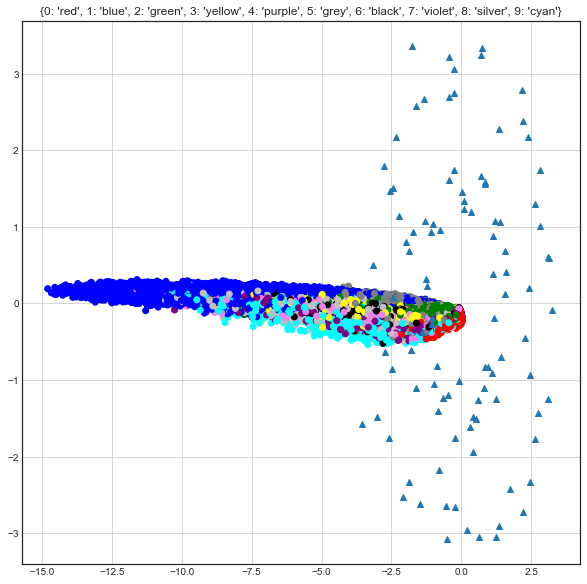

 iter: 24 batch: 19900 range: 3.9883221538436285e-06 recon cost: 0.22402075 zero cost: 0.15207183								 one  cost: 0.28953135 fake cost: 2.2392783

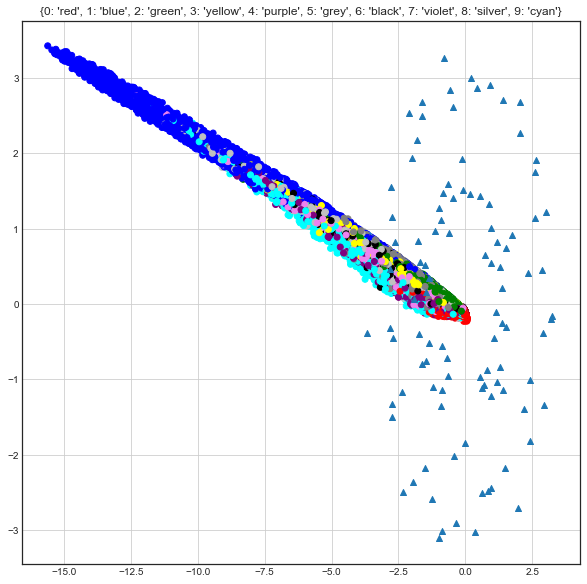

 iter: 25 batch: 19900 range: 3.5894899384592657e-06 recon cost: 0.2237027 zero cost: 0.13645925								 one  cost: 0.26252437 fake cost: 2.36954057

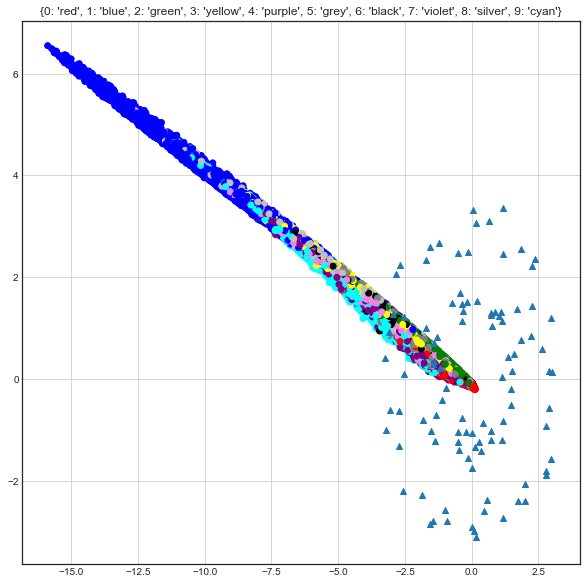

 iter: 26 batch: 19900 range: 3.230540944613339e-06 recon cost: 0.22331029 zero cost: 0.13067499								 one  cost: 0.26634848 fake cost: 2.51262431

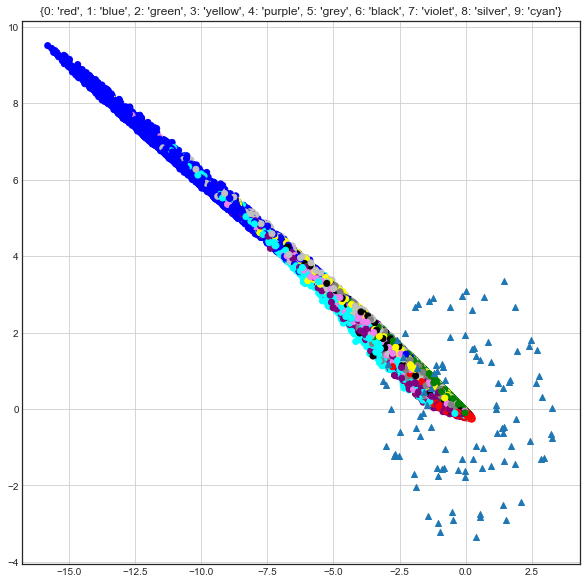

 iter: 27 batch: 19900 range: 2.907486850152005e-06 recon cost: 0.22270453 zero cost: 0.14739262								 one  cost: 0.26324138 fake cost: 2.4756892

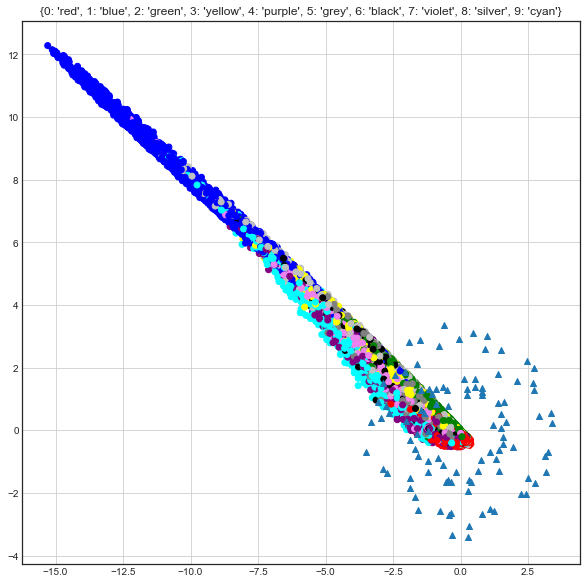

 iter: 28 batch: 19900 range: 2.616738165136805e-06 recon cost: 0.2215917 zero cost: 0.18148686								 one  cost: 0.3485521 fake cost: 2.286961284

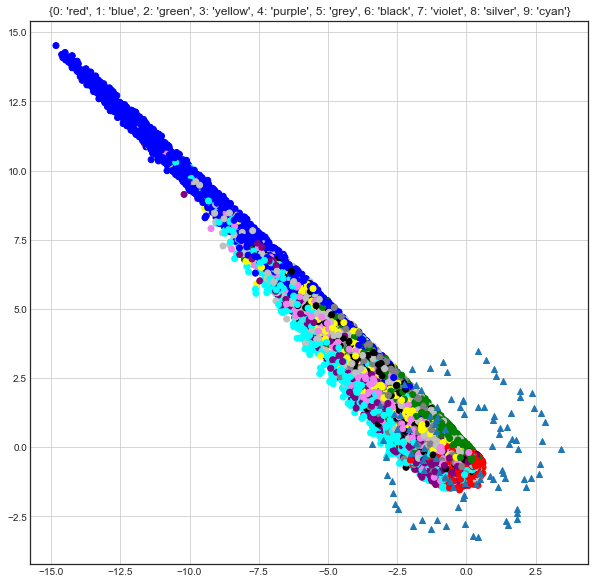

 iter: 29 batch: 19900 range: 2.3550643486231244e-06 recon cost: 0.21984455 zero cost: 0.2314141								 one  cost: 0.50018996 fake cost: 2.26039236

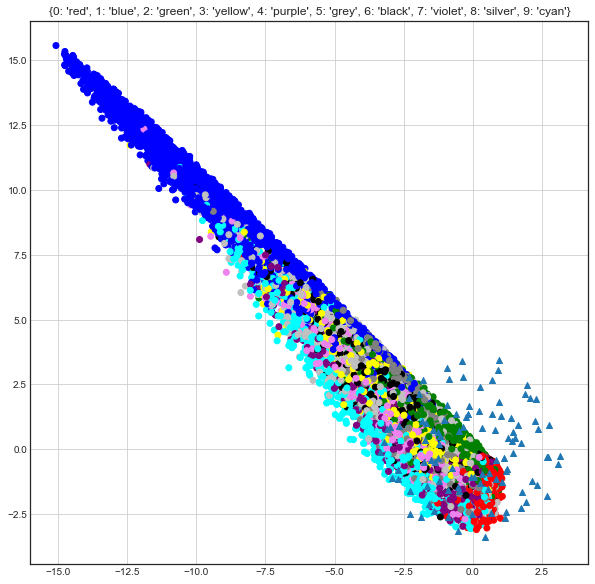

 iter: 30 batch: 19900 range: 2.119557913760812e-06 recon cost: 0.21781026 zero cost: 0.29733858								 one  cost: 0.67465746 fake cost: 2.1929557

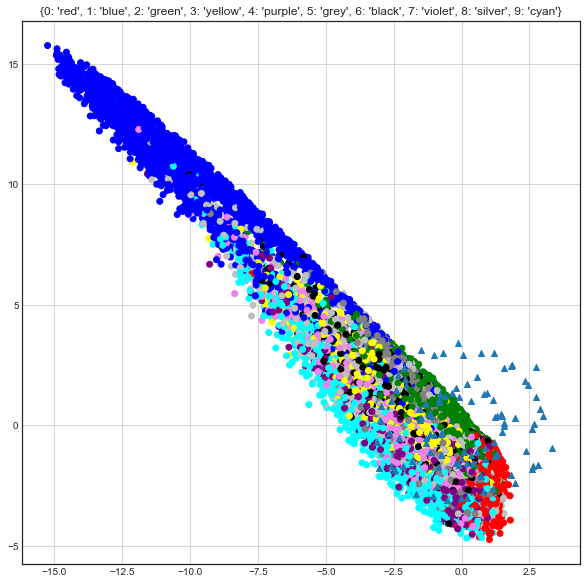

 iter: 31 batch: 19900 range: 1.907602122384731e-06 recon cost: 0.21558738 zero cost: 0.33005646								 one  cost: 0.6128346 fake cost: 2.20829387

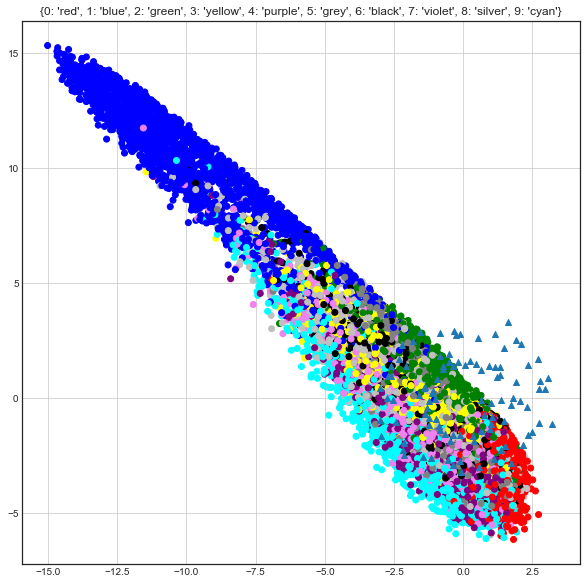

 iter: 32 batch: 19900 range: 1.7168419101462578e-06 recon cost: 0.21352021 zero cost: 0.33454877								 one  cost: 0.5930481 fake cost: 2.22214659

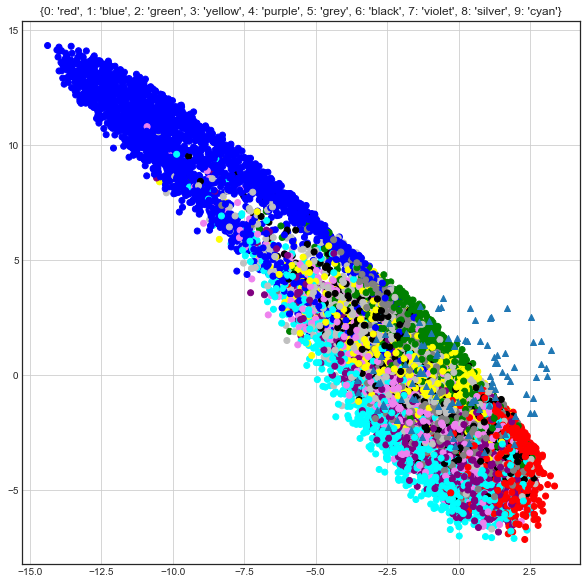

 iter: 33 batch: 19900 range: 1.545157719131632e-06 recon cost: 0.21183515 zero cost: 0.35346812								 one  cost: 0.56704545 fake cost: 2.1244556

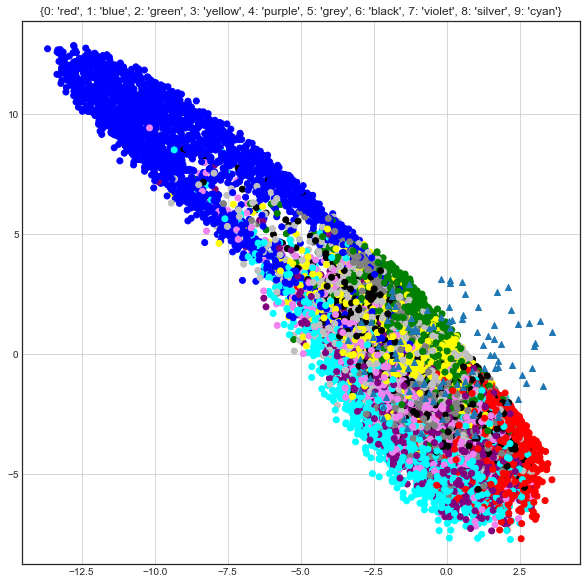

 iter: 34 batch: 19900 range: 1.3906419472184687e-06 recon cost: 0.21051763 zero cost: 0.3872359								 one  cost: 0.5859337 fake cost: 1.916035413

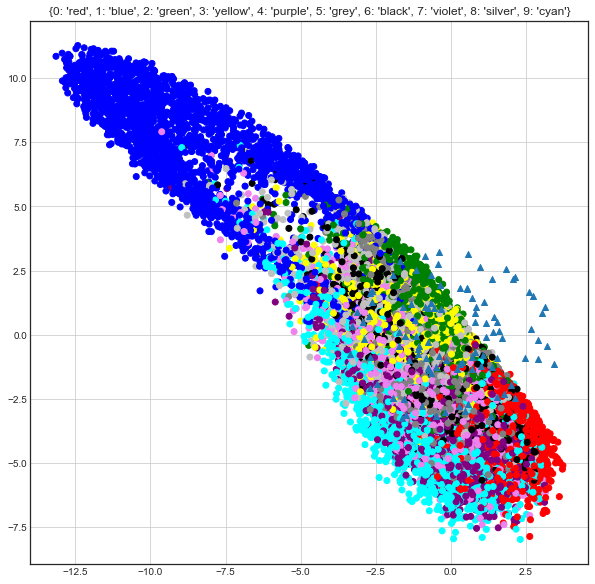

 iter: 35 batch: 19900 range: 1.251577752496622e-06 recon cost: 0.2094998 zero cost: 0.41009155								 one  cost: 0.5500634 fake cost: 1.738549445

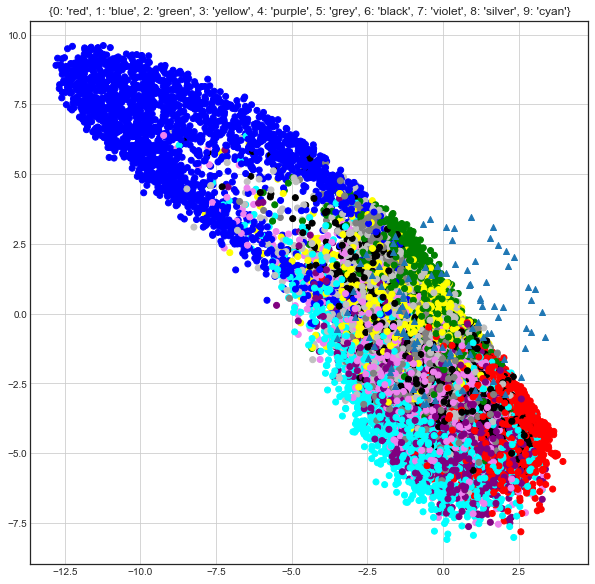

 iter: 36 batch: 19900 range: 1.1264199772469597e-06 recon cost: 0.20871039 zero cost: 0.4240296								 one  cost: 0.52856827 fake cost: 1.55543494

In [ ]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets

#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.5,noise=.1)
        prior_z = prior_z * 3
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00002,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00002,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.9    
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-5,5);plt.ylim(-5,5);
        plt.grid();plt.show()

 iter: 0 batch: 19900 range: 5e-05 recon cost: 0.29489037 zero cost: 0.0074756905								 one  cost: 0.036539022 fake cost: 6.5344415

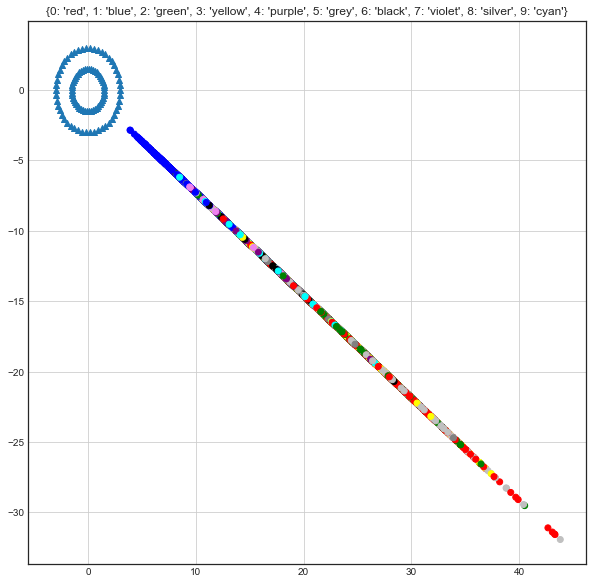

 iter: 1 batch: 19900 range: 4.5e-05 recon cost: 0.26480117 zero cost: 0.004189382								 one  cost: 0.010608081 fake cost: 7.55140949

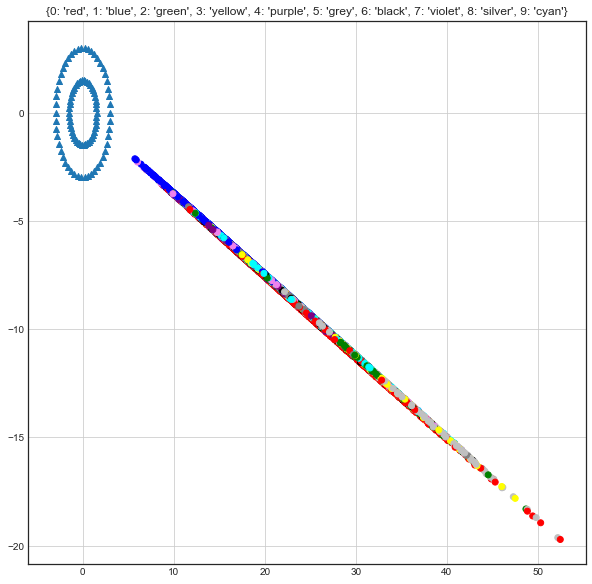

 iter: 2 batch: 19900 range: 4.05e-05 recon cost: 0.25807744 zero cost: 0.0035634867								 one  cost: 0.005112527 fake cost: 8.290028111

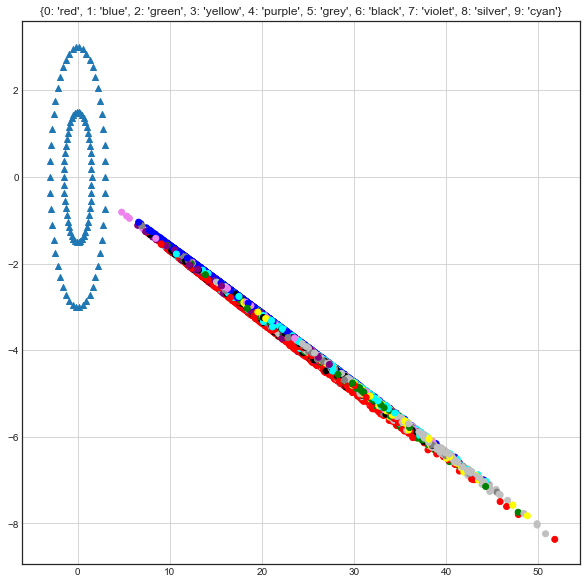

 iter: 3 batch: 19900 range: 3.6450000000000005e-05 recon cost: 0.2545525 zero cost: 0.0056827776								 one  cost: 0.003355507 fake cost: 9.0199334245

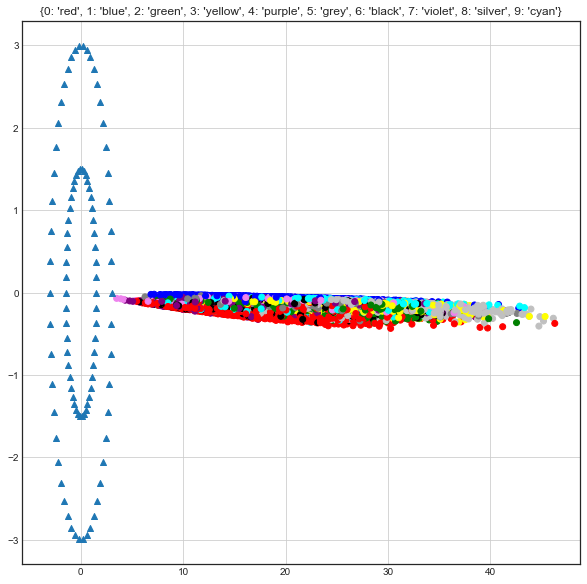

 iter: 4 batch: 19900 range: 3.280500000000001e-05 recon cost: 0.25233734 zero cost: 0.012068205								 one  cost: 0.0030730197 fake cost: 9.848499766

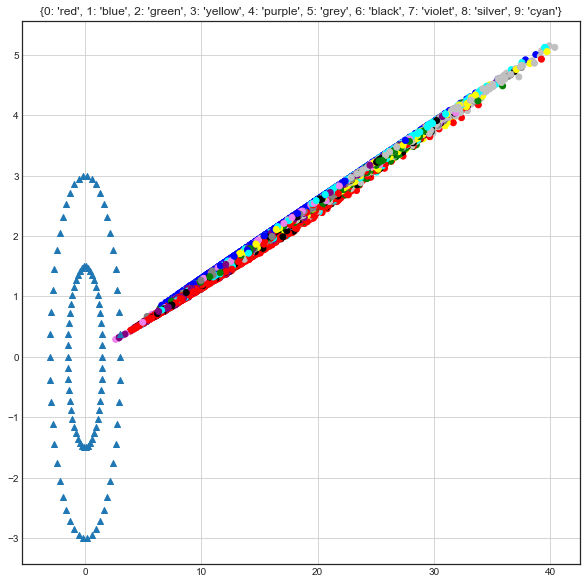

 iter: 5 batch: 19900 range: 2.952450000000001e-05 recon cost: 0.25022766 zero cost: 0.02453901								 one  cost: 0.003108722 fake cost: 10.98780284835

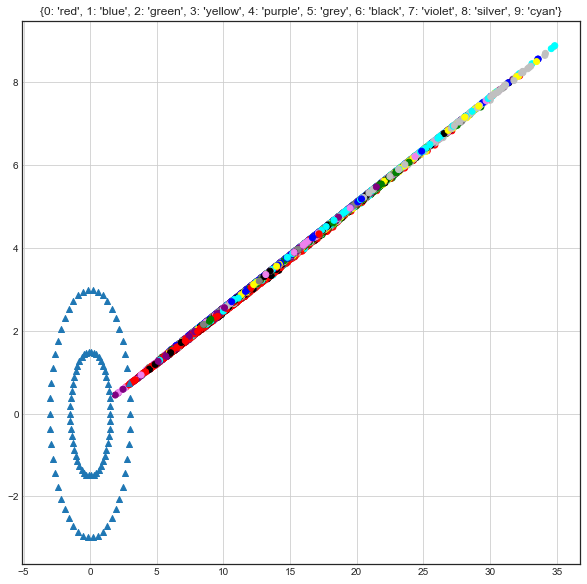

 iter: 6 batch: 19900 range: 2.657205000000001e-05 recon cost: 0.24797957 zero cost: 0.043970138								 one  cost: 0.0036269242 fake cost: 11.75154928

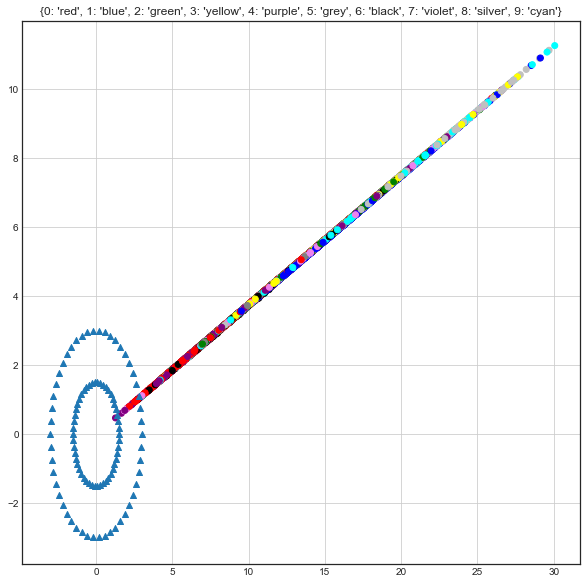

 iter: 7 batch: 19900 range: 2.391484500000001e-05 recon cost: 0.24584219 zero cost: 0.07319802								 one  cost: 0.0051092994 fake cost: 11.893275575

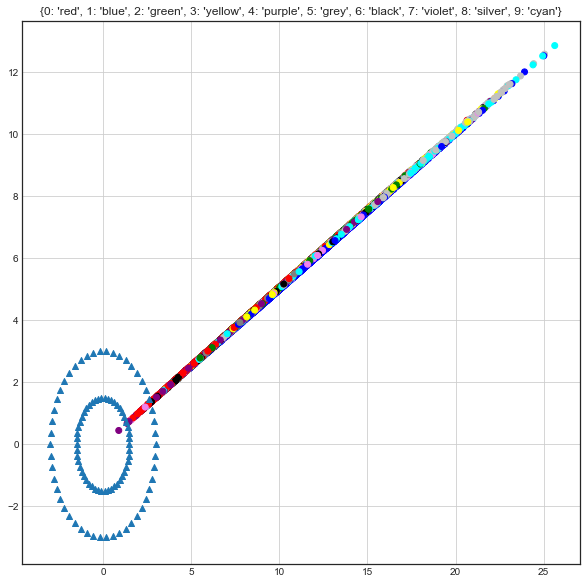

 iter: 8 batch: 19900 range: 2.152336050000001e-05 recon cost: 0.24393037 zero cost: 0.105122976								 one  cost: 0.008027297 fake cost: 11.461346675

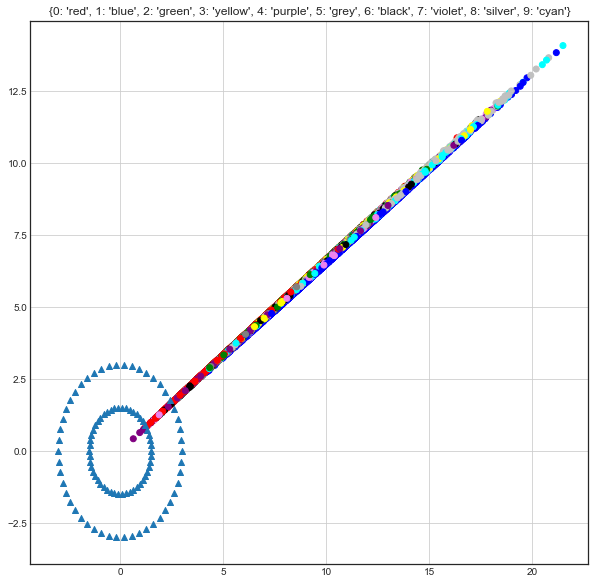

 iter: 9 batch: 19900 range: 1.937102445000001e-05 recon cost: 0.2421185 zero cost: 0.12288139								 one  cost: 0.015577001 fake cost: 10.2370421222

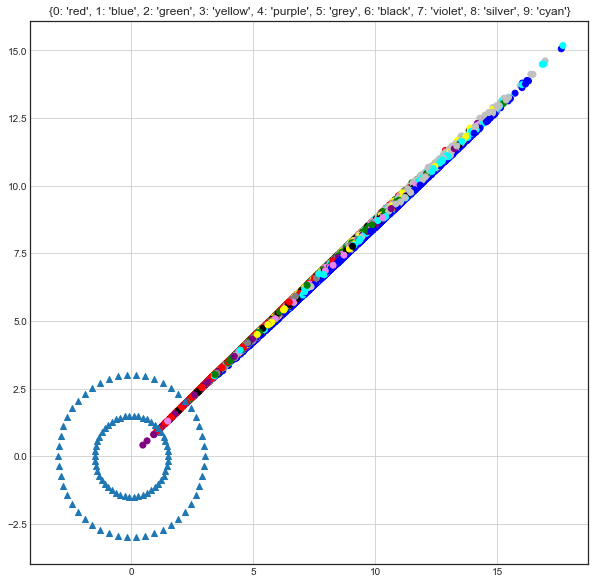

 iter: 10 batch: 19900 range: 1.7433922005000008e-05 recon cost: 0.24040647 zero cost: 0.12905777								 one  cost: 0.02295954 fake cost: 9.1806827585

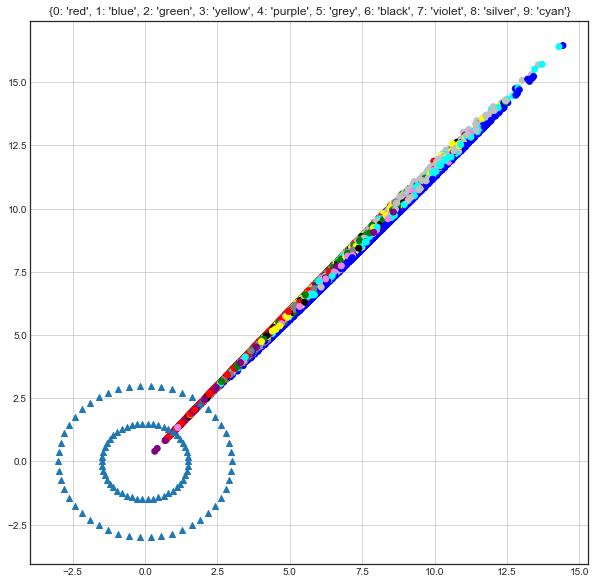

 iter: 11 batch: 19900 range: 1.569052980450001e-05 recon cost: 0.23881328 zero cost: 0.12278936								 one  cost: 0.028340047 fake cost: 8.431781142

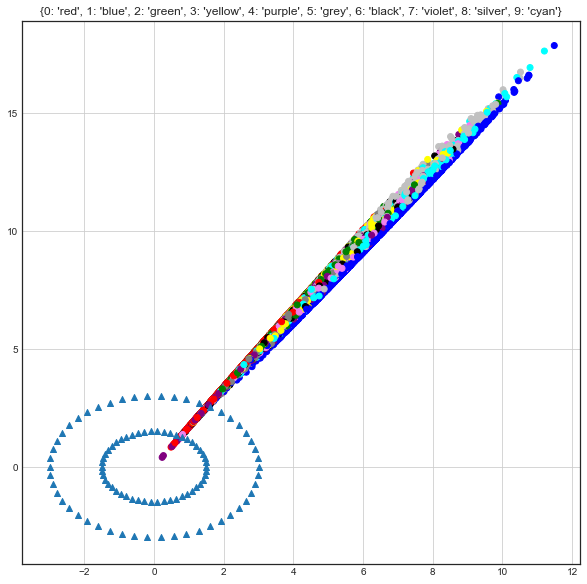

 iter: 12 batch: 19900 range: 1.4121476824050009e-05 recon cost: 0.23738004 zero cost: 0.1169293								 one  cost: 0.033043645 fake cost: 8.036962555

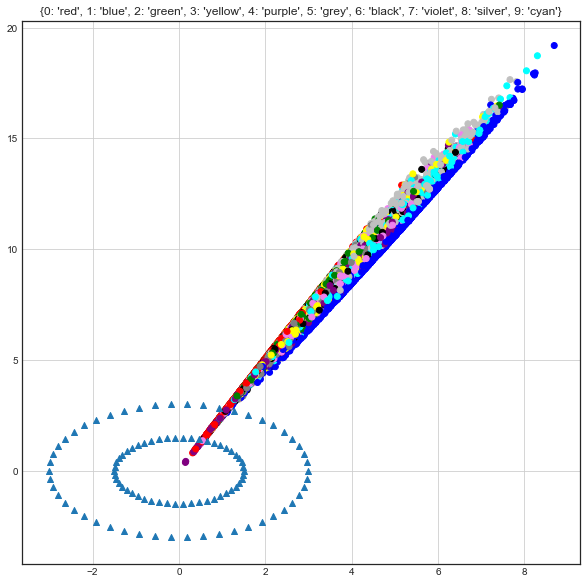

 iter: 13 batch: 19900 range: 1.2709329141645008e-05 recon cost: 0.23632334 zero cost: 0.10076701								 one  cost: 0.041483182 fake cost: 7.76455265

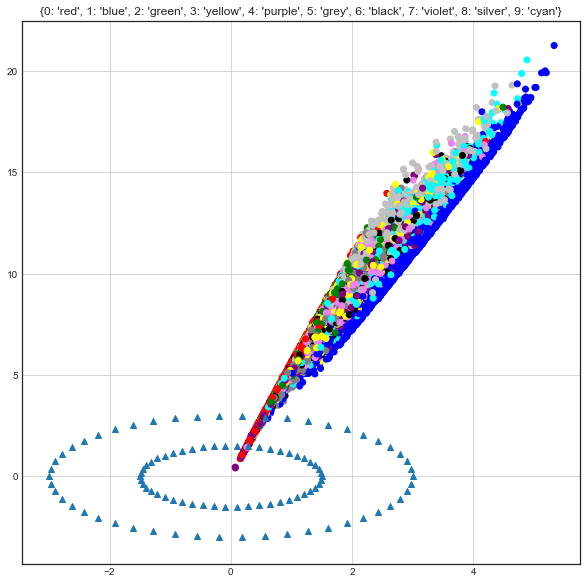

 iter: 14 batch: 19900 range: 1.1438396227480508e-05 recon cost: 0.23533784 zero cost: 0.09210659								 one  cost: 0.032873407 fake cost: 7.86088124

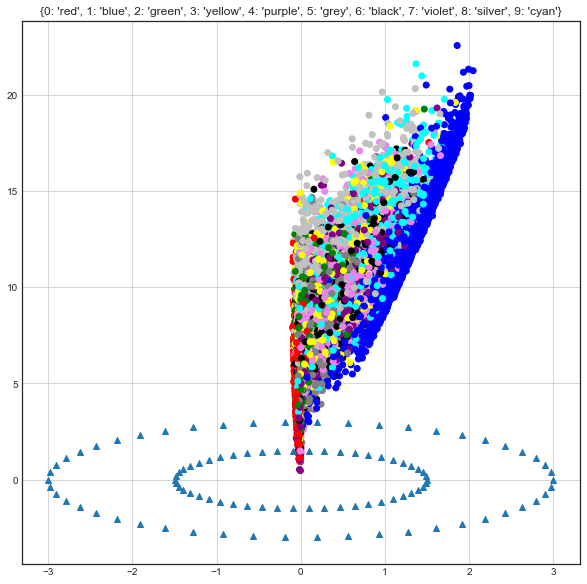

 iter: 15 batch: 19900 range: 1.0294556604732457e-05 recon cost: 0.23449595 zero cost: 0.085537046								 one  cost: 0.03425617 fake cost: 8.230244943

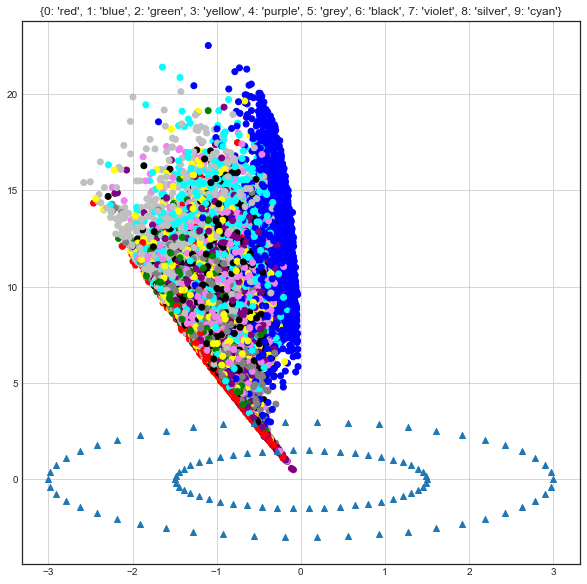

 iter: 16 batch: 19900 range: 9.265100944259211e-06 recon cost: 0.23335698 zero cost: 0.08681246								 one  cost: 0.035819888 fake cost: 8.644685534

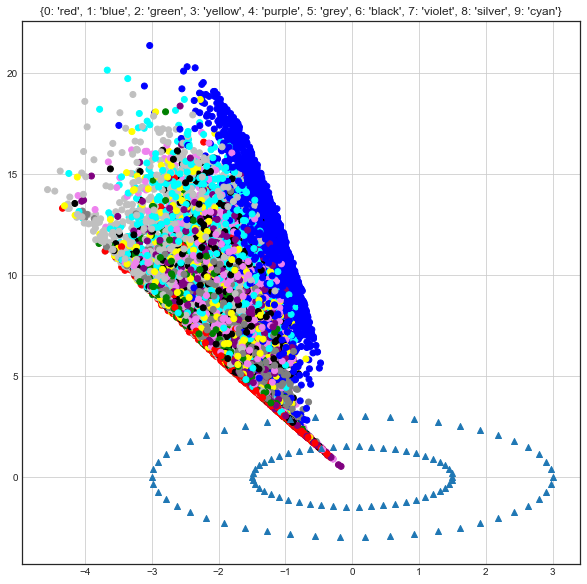

 iter: 17 batch: 19900 range: 8.33859084983329e-06 recon cost: 0.23203728 zero cost: 0.09624741								 one  cost: 0.04099522 fake cost: 8.616014582

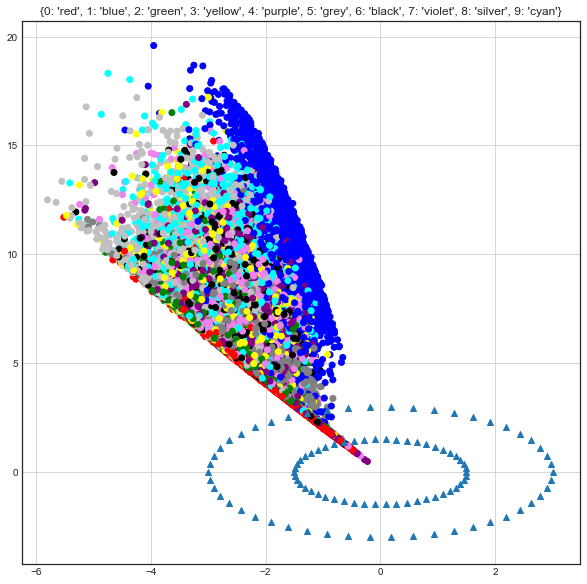

 iter: 18 batch: 19900 range: 7.504731764849961e-06 recon cost: 0.23060691 zero cost: 0.11345376								 one  cost: 0.051797815 fake cost: 8.121584923

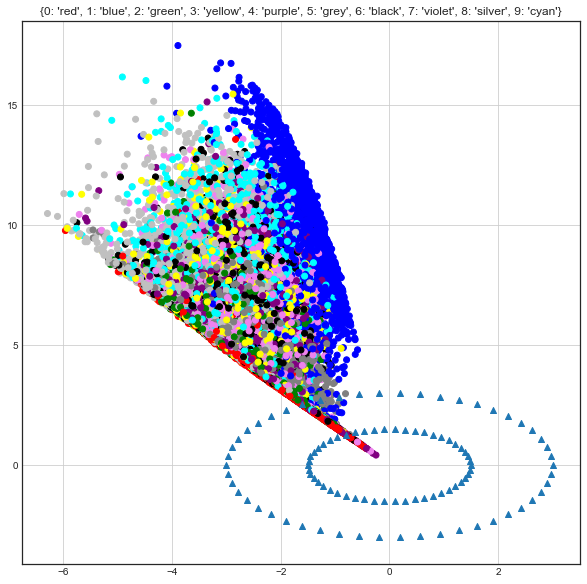

 iter: 19 batch: 19900 range: 6.754258588364965e-06 recon cost: 0.22885728 zero cost: 0.15308233								 one  cost: 0.08904178 fake cost: 6.015332874

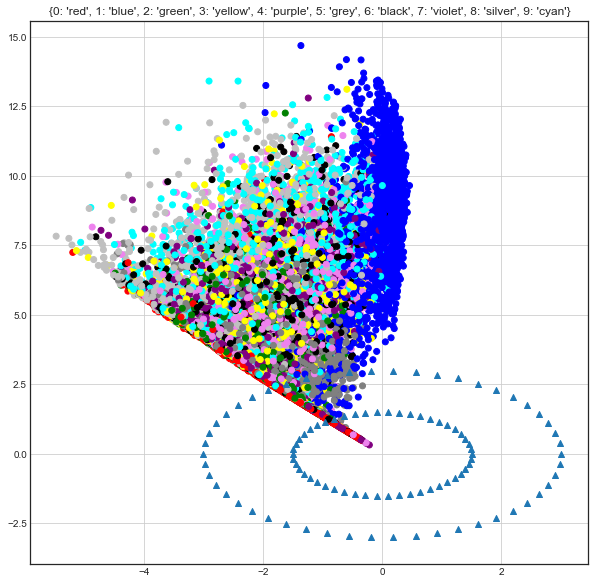

 iter: 20 batch: 19900 range: 6.078832729528469e-06 recon cost: 0.22734223 zero cost: 0.24661206								 one  cost: 0.22922702 fake cost: 4.27915873

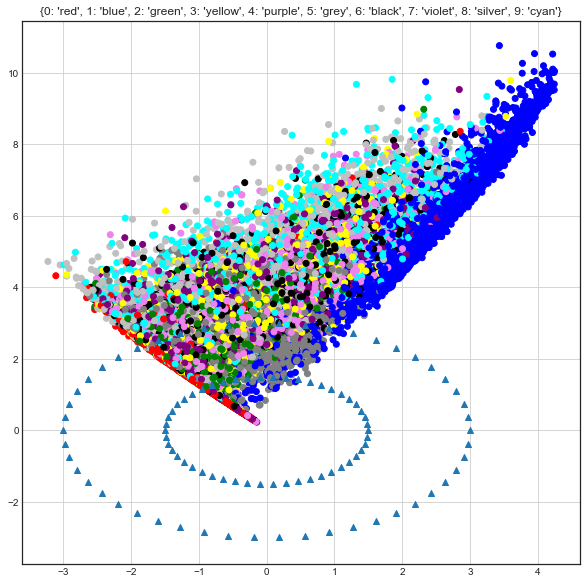

 iter: 21 batch: 19900 range: 5.470949456575622e-06 recon cost: 0.2256955 zero cost: 0.35474873								 one  cost: 0.42462742 fake cost: 2.48287176

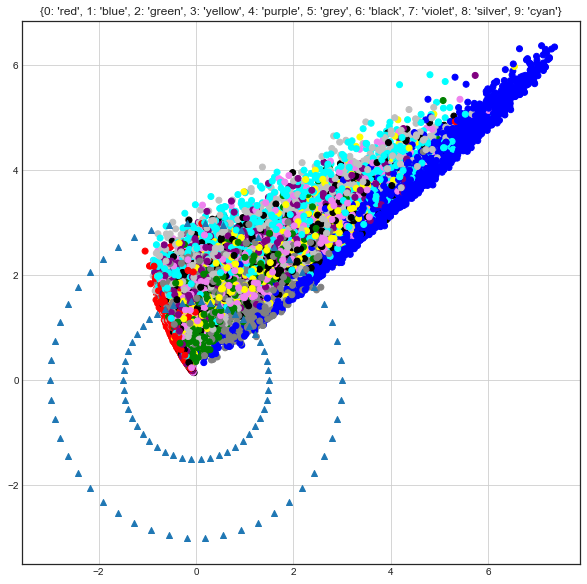

 iter: 22 batch: 19900 range: 4.92385451091806e-06 recon cost: 0.22496577 zero cost: 0.33148593								 one  cost: 0.44701165 fake cost: 1.9120665

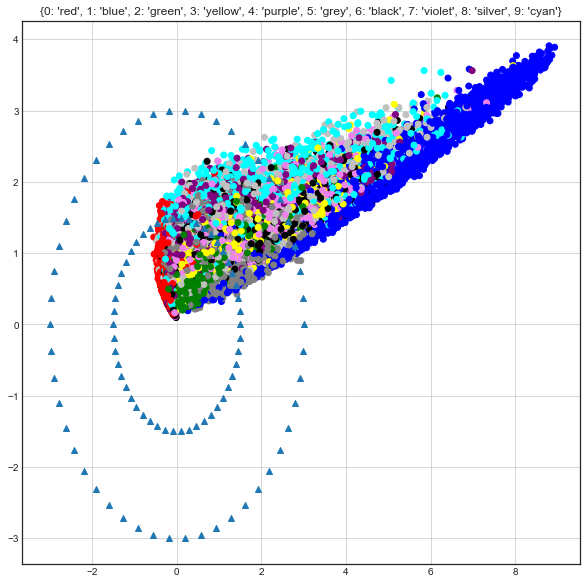

 iter: 23 batch: 19900 range: 4.431469059826254e-06 recon cost: 0.22418202 zero cost: 0.3012913								 one  cost: 0.4180948 fake cost: 1.798343536

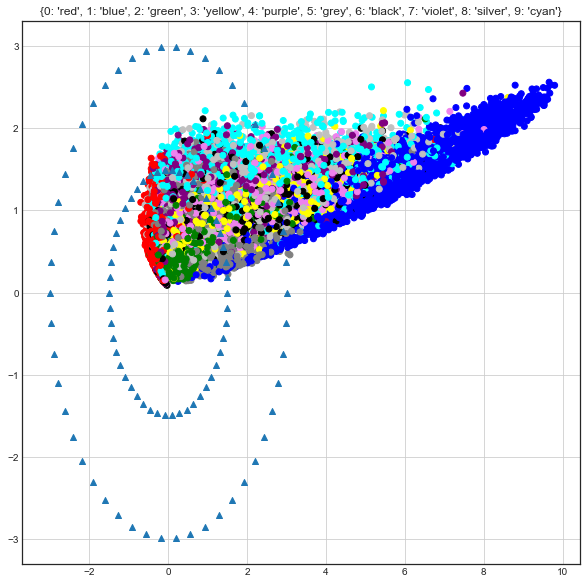

 iter: 24 batch: 19900 range: 3.9883221538436285e-06 recon cost: 0.22301641 zero cost: 0.29180542								 one  cost: 0.4006729 fake cost: 1.72849589

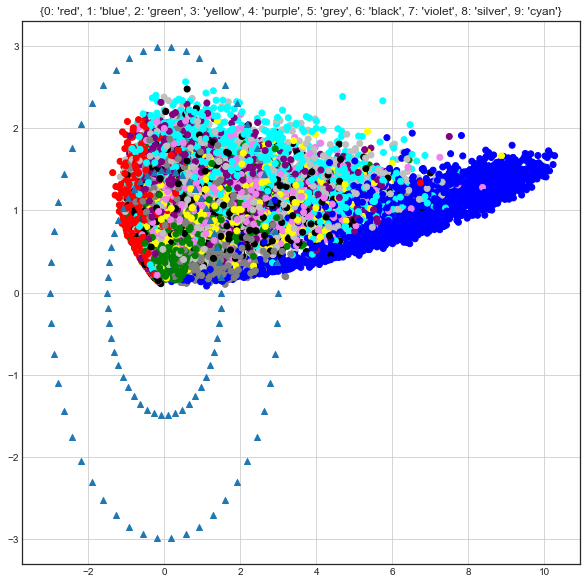

 iter: 25 batch: 19900 range: 3.5894899384592657e-06 recon cost: 0.22127524 zero cost: 0.285451								 one  cost: 0.4619949 fake cost: 1.7439694297

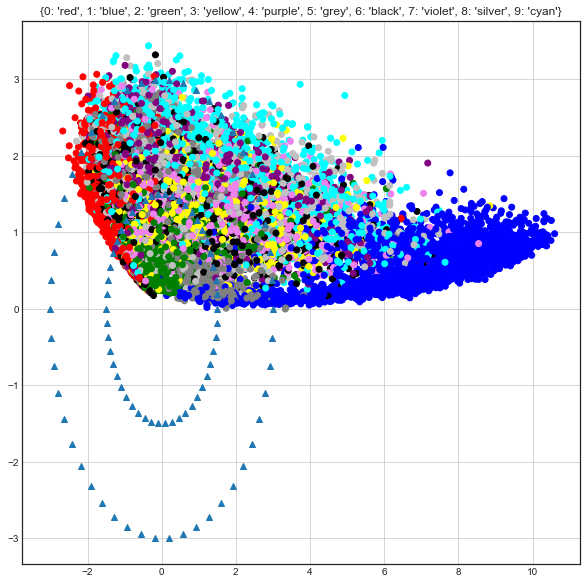

 iter: 26 batch: 19900 range: 3.230540944613339e-06 recon cost: 0.21880147 zero cost: 0.28521487								 one  cost: 0.548547 fake cost: 1.838407278

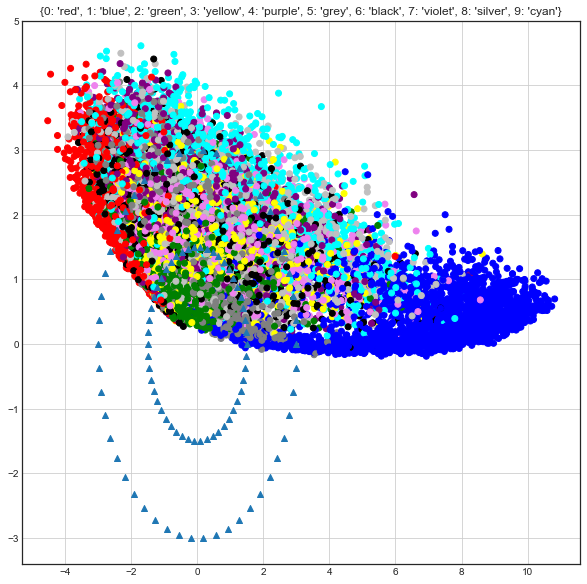

 iter: 27 batch: 19900 range: 2.907486850152005e-06 recon cost: 0.2162218 zero cost: 0.29182902								 one  cost: 0.54130757 fake cost: 1.93330066

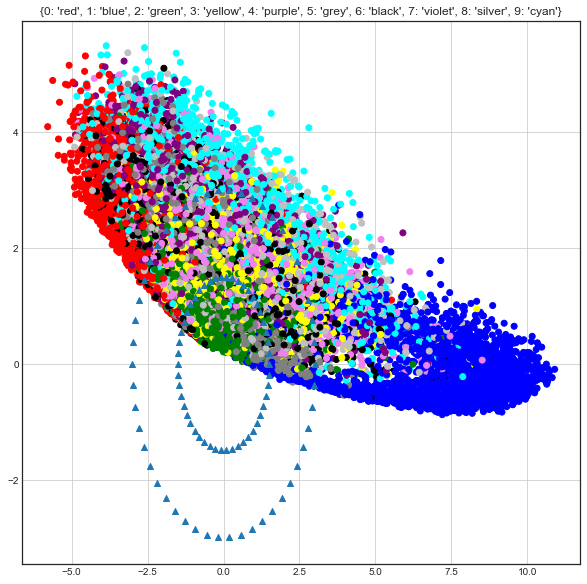

 iter: 28 batch: 19900 range: 2.616738165136805e-06 recon cost: 0.2140728 zero cost: 0.31980708								 one  cost: 0.51362735 fake cost: 1.89879327

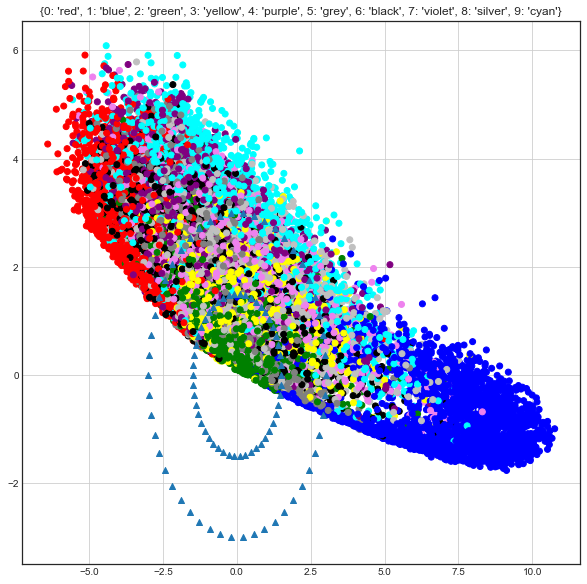

 iter: 29 batch: 19900 range: 2.3550643486231244e-06 recon cost: 0.21237564 zero cost: 0.35487193								 one  cost: 0.48984545 fake cost: 1.7958522

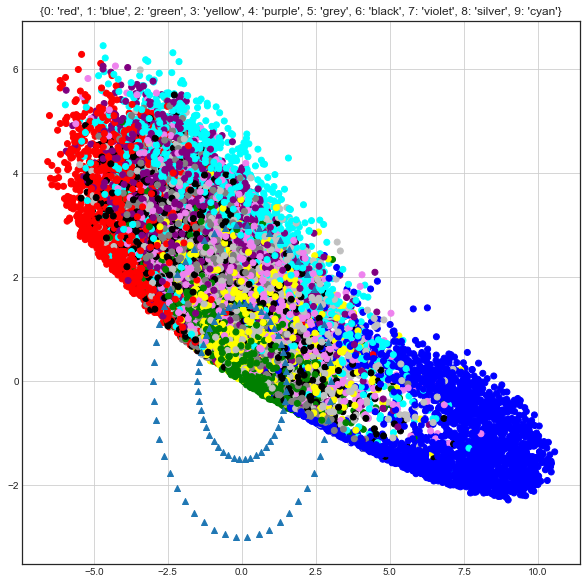

 iter: 30 batch: 19900 range: 2.119557913760812e-06 recon cost: 0.21102835 zero cost: 0.3869493								 one  cost: 0.4761714 fake cost: 1.674379891

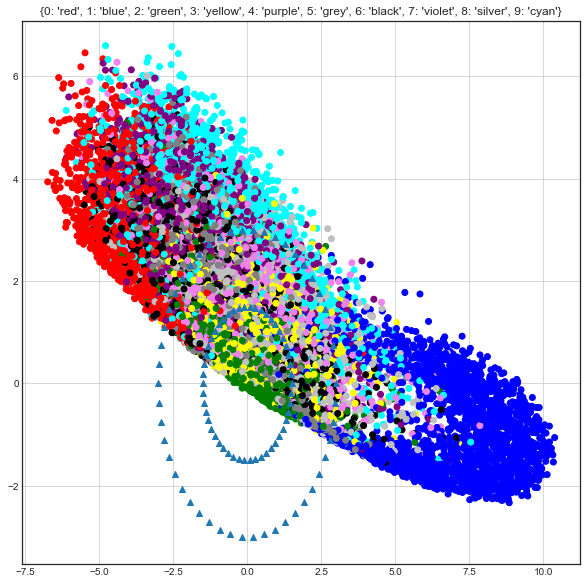

 iter: 31 batch: 19900 range: 1.907602122384731e-06 recon cost: 0.2099734 zero cost: 0.41046375								 one  cost: 0.4749813 fake cost: 1.561340565

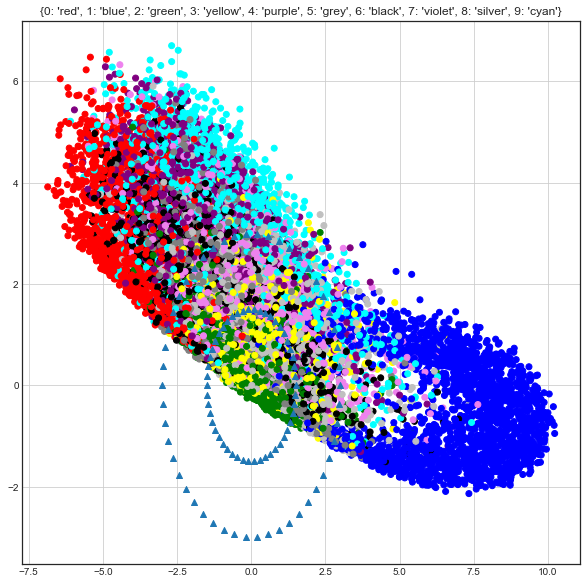

 iter: 32 batch: 19900 range: 1.7168419101462578e-06 recon cost: 0.20915528 zero cost: 0.42841884								 one  cost: 0.47847405 fake cost: 1.4524319

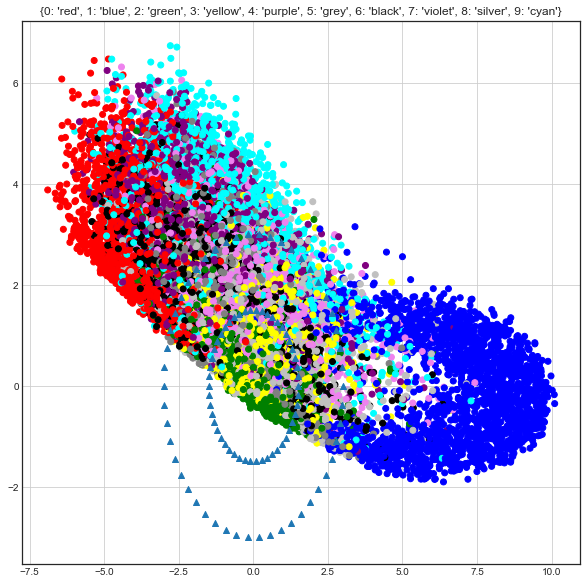

 iter: 33 batch: 19900 range: 1.545157719131632e-06 recon cost: 0.20851944 zero cost: 0.43917918								 one  cost: 0.48354304 fake cost: 1.3743799

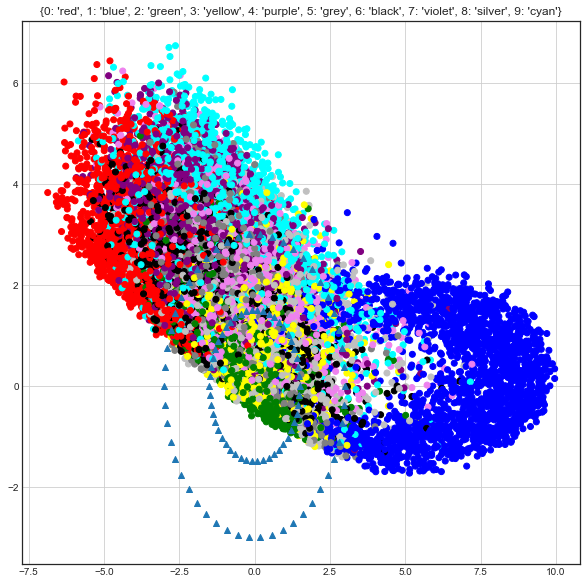

 iter: 34 batch: 19900 range: 1.3906419472184687e-06 recon cost: 0.20800465 zero cost: 0.4451925								 one  cost: 0.48992062 fake cost: 1.32689552

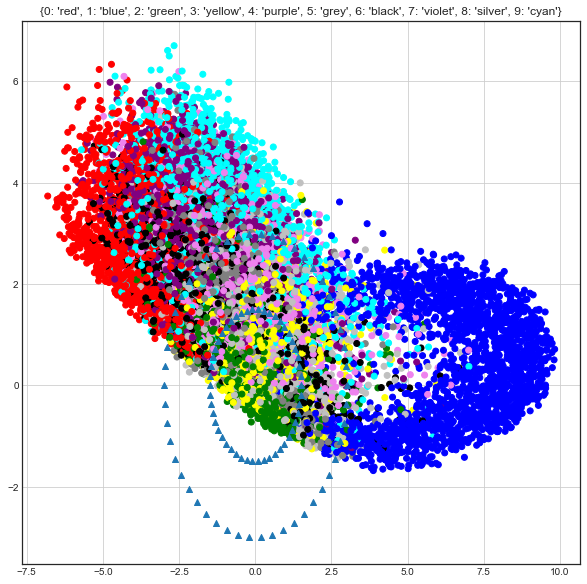

 iter: 35 batch: 19900 range: 1.251577752496622e-06 recon cost: 0.20756269 zero cost: 0.4504832								 one  cost: 0.49386674 fake cost: 1.29517442

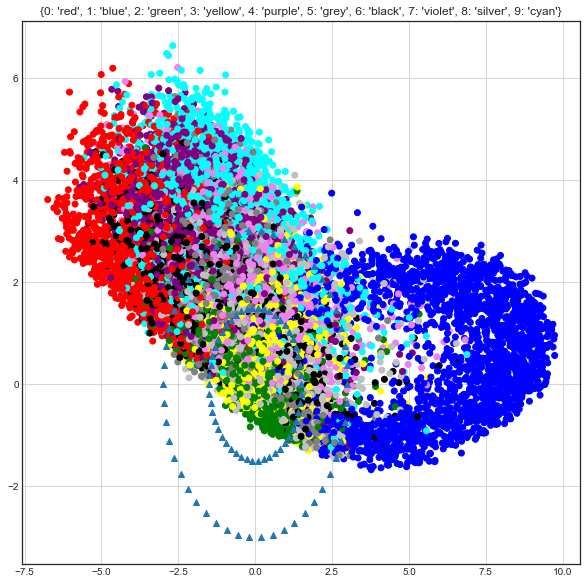

 iter: 36 batch: 19900 range: 1.1264199772469597e-06 recon cost: 0.20717016 zero cost: 0.45555547								 one  cost: 0.49677238 fake cost: 1.2717834

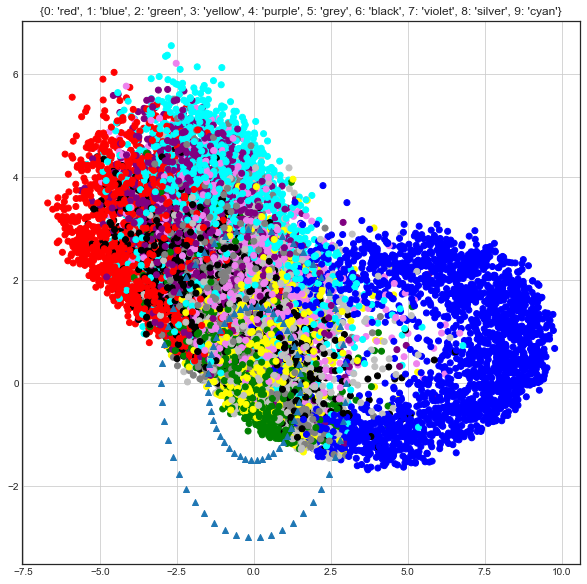

 iter: 37 batch: 19900 range: 1.0137779795222638e-06 recon cost: 0.20680664 zero cost: 0.45914665								 one  cost: 0.5011097 fake cost: 1.25796092

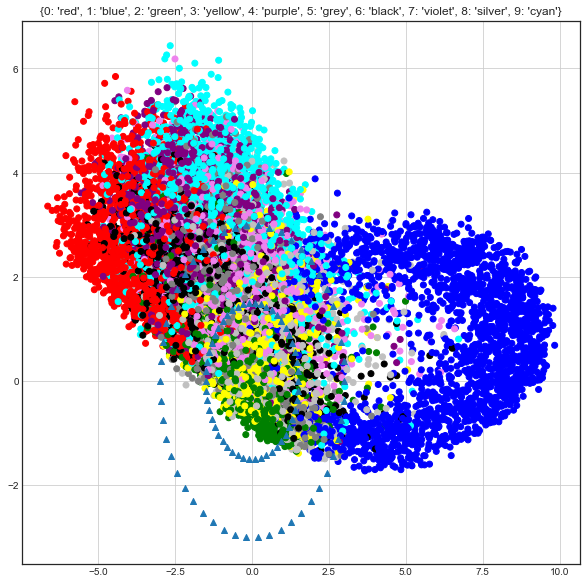

 iter: 38 batch: 19900 range: 9.124001815700375e-07 recon cost: 0.20645899 zero cost: 0.46286532								 one  cost: 0.5054898 fake cost: 1.24582048

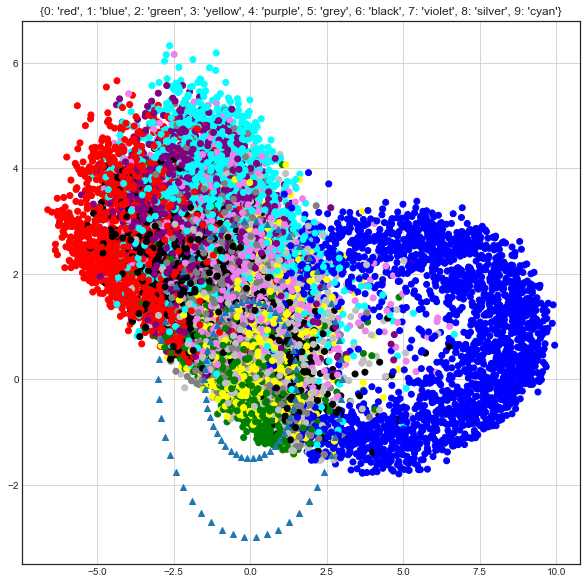

 iter: 39 batch: 19900 range: 8.211601634130337e-07 recon cost: 0.20611325 zero cost: 0.46886647								 one  cost: 0.5057578 fake cost: 1.22459777

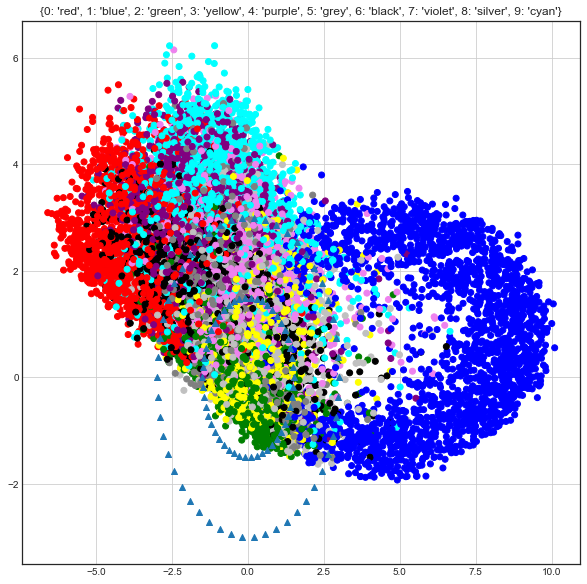

 iter: 40 batch: 19900 range: 7.390441470717303e-07 recon cost: 0.2057667 zero cost: 0.47321305								 one  cost: 0.5094594 fake cost: 1.213316834

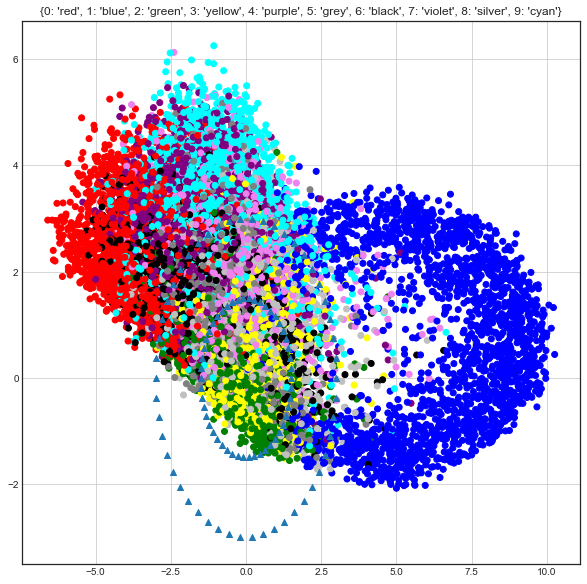

 iter: 41 batch: 19900 range: 6.651397323645573e-07 recon cost: 0.20541237 zero cost: 0.4770201								 one  cost: 0.51332295 fake cost: 1.20489743

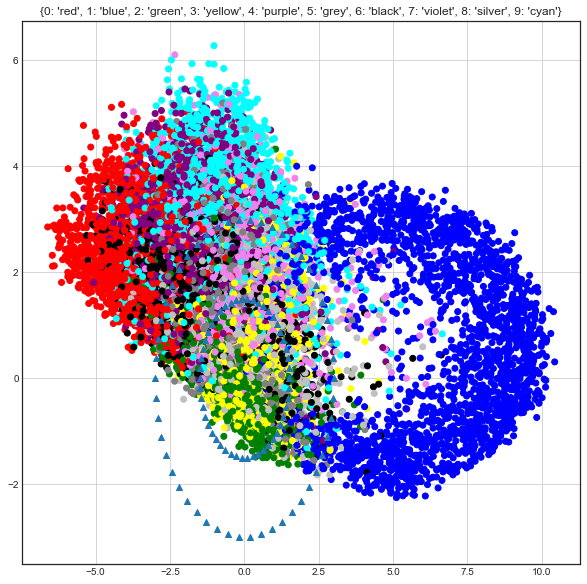

 iter: 42 batch: 19900 range: 5.986257591281016e-07 recon cost: 0.20504479 zero cost: 0.48104								 one  cost: 0.51716596 fake cost: 1.2011802486

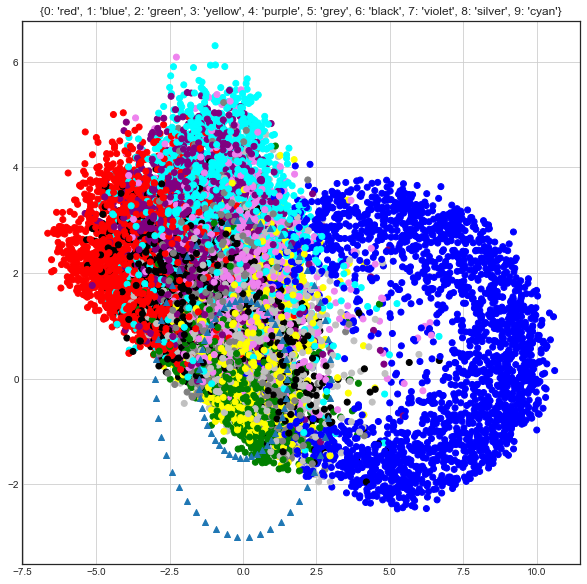

 iter: 43 batch: 19900 range: 5.387631832152914e-07 recon cost: 0.20465669 zero cost: 0.48394158								 one  cost: 0.52000433 fake cost: 1.1973855

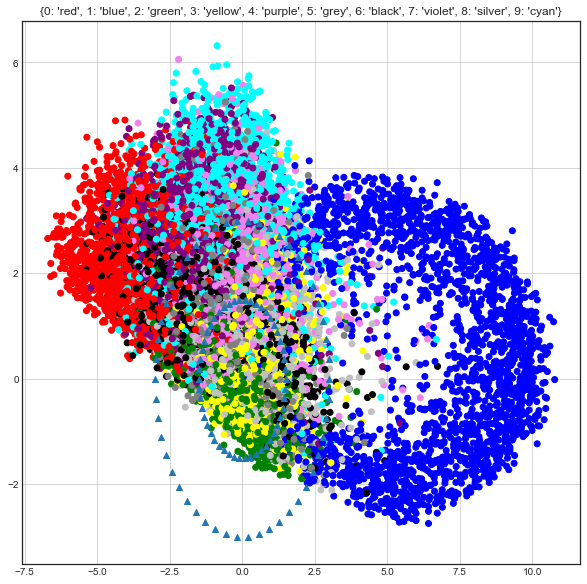

 iter: 44 batch: 19900 range: 4.848868648937623e-07 recon cost: 0.20424108 zero cost: 0.48559132								 one  cost: 0.52322036 fake cost: 1.1976272

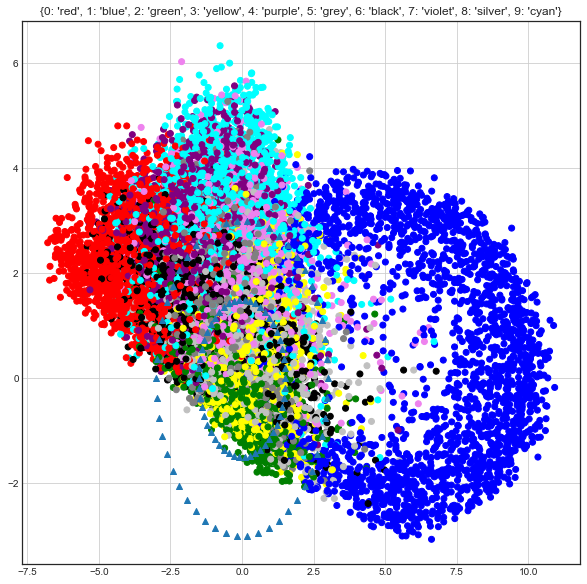

 iter: 45 batch: 19900 range: 4.3639817840438605e-07 recon cost: 0.20379364 zero cost: 0.48713052								 one  cost: 0.5261142 fake cost: 1.19815243

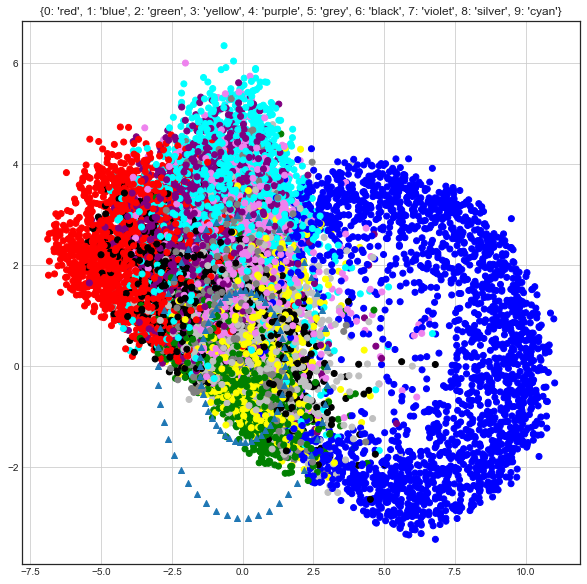

 iter: 46 batch: 19900 range: 3.9275836056394745e-07 recon cost: 0.20331392 zero cost: 0.48470467								 one  cost: 0.5318842 fake cost: 1.21445438

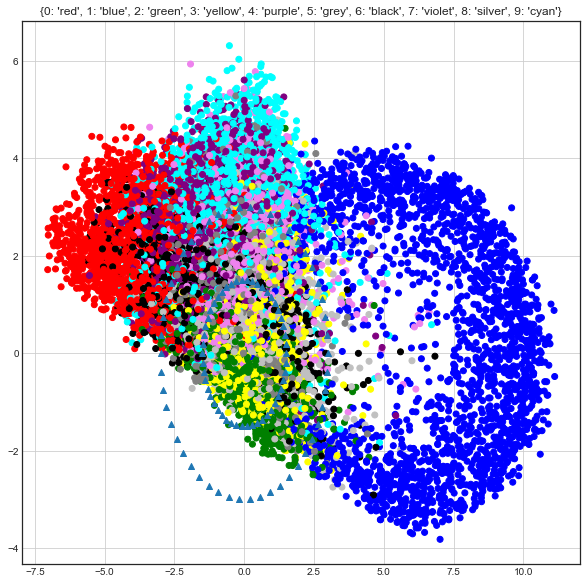

 iter: 47 batch: 19900 range: 3.5348252450755274e-07 recon cost: 0.20279394 zero cost: 0.48403388								 one  cost: 0.53759825 fake cost: 1.2330592

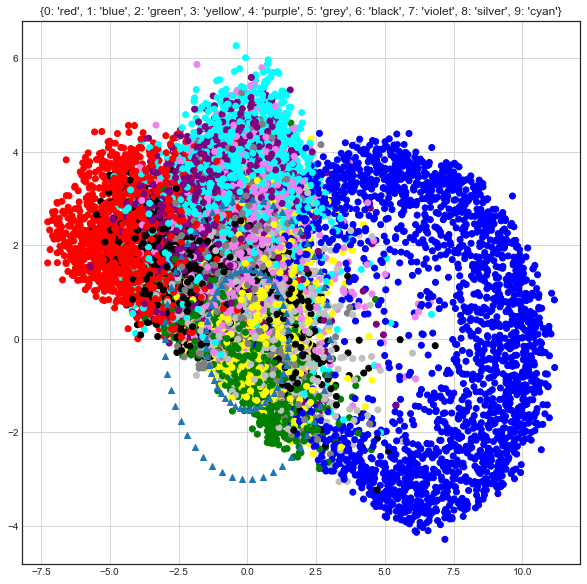

 iter: 48 batch: 19900 range: 3.1813427205679747e-07 recon cost: 0.20222987 zero cost: 0.48323962								 one  cost: 0.5460159 fake cost: 1.26424842

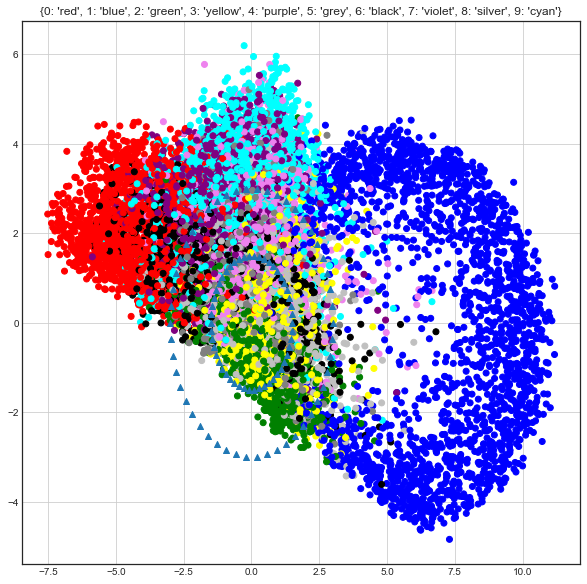

 iter: 49 batch: 19900 range: 2.8632084485111774e-07 recon cost: 0.20163527 zero cost: 0.48230976								 one  cost: 0.55313325 fake cost: 1.3045684

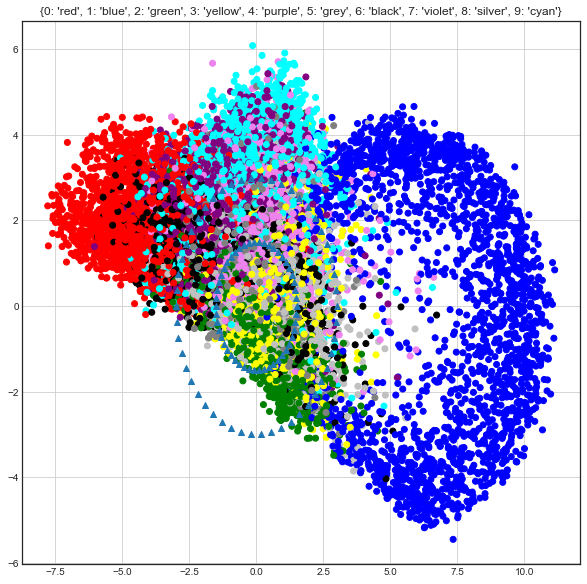

 iter: 50 batch: 19900 range: 2.57688760366006e-07 recon cost: 0.20102017 zero cost: 0.4823206								 one  cost: 0.5562408 fake cost: 1.3455479534

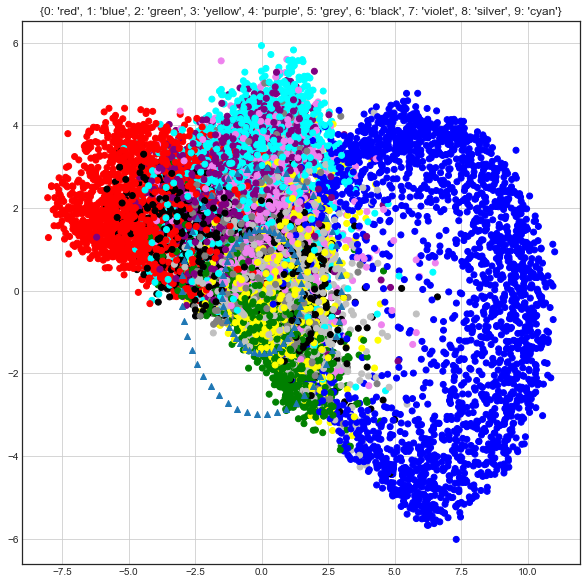

 iter: 51 batch: 19900 range: 2.319198843294054e-07 recon cost: 0.20040299 zero cost: 0.48821676								 one  cost: 0.55259955 fake cost: 1.3628849

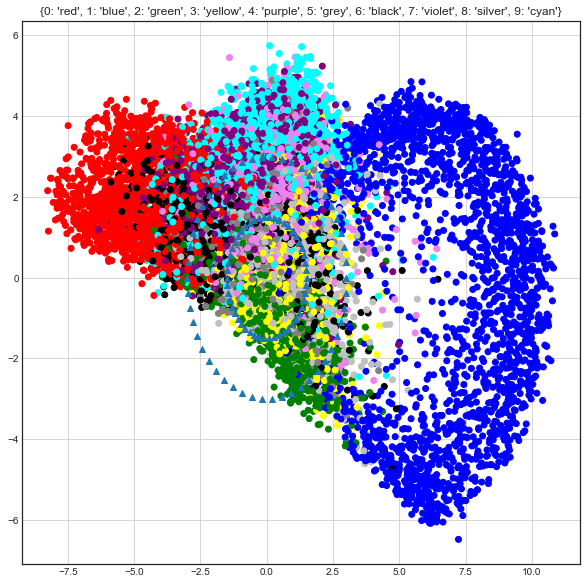

 iter: 52 batch: 19900 range: 2.0872789589646487e-07 recon cost: 0.19979143 zero cost: 0.49523556								 one  cost: 0.54788107 fake cost: 1.3630478

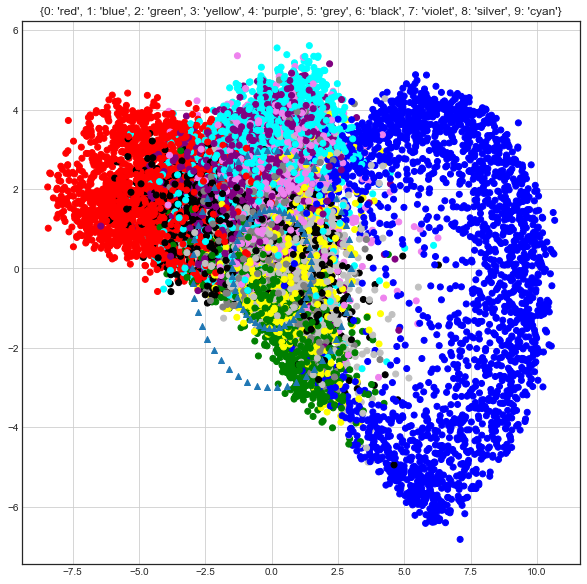

 iter: 53 batch: 19900 range: 1.8785510630681839e-07 recon cost: 0.19918181 zero cost: 0.49987698								 one  cost: 0.5451819 fake cost: 1.360150586

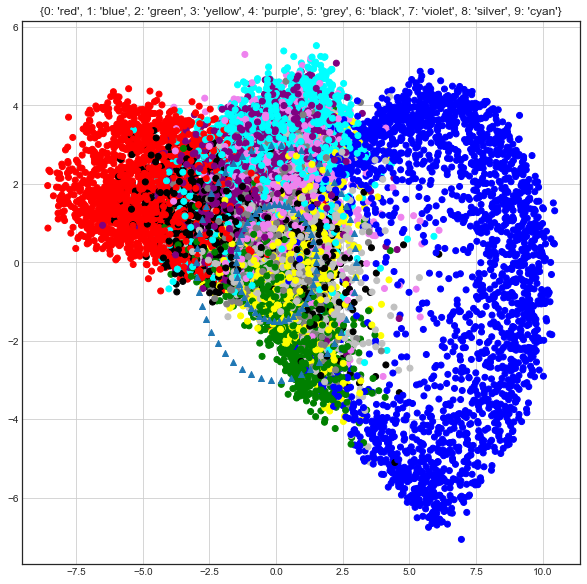

 iter: 54 batch: 19900 range: 1.6906959567613656e-07 recon cost: 0.19857313 zero cost: 0.5026184								 one  cost: 0.54452014 fake cost: 1.35684697

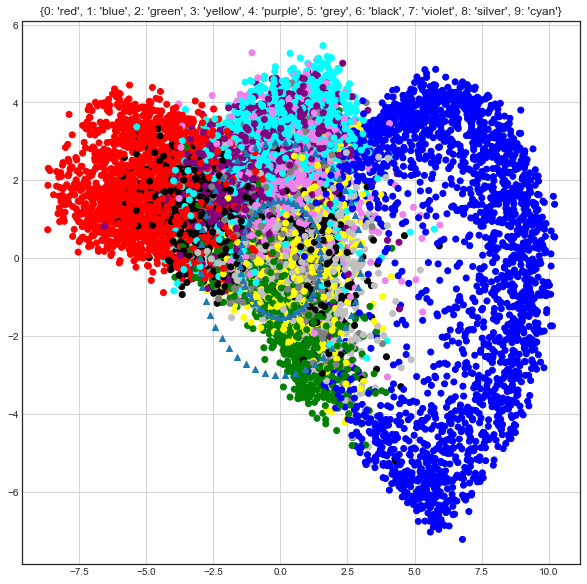

 iter: 55 batch: 19900 range: 1.521626361085229e-07 recon cost: 0.19796078 zero cost: 0.5070739								 one  cost: 0.5450063 fake cost: 1.3488203977

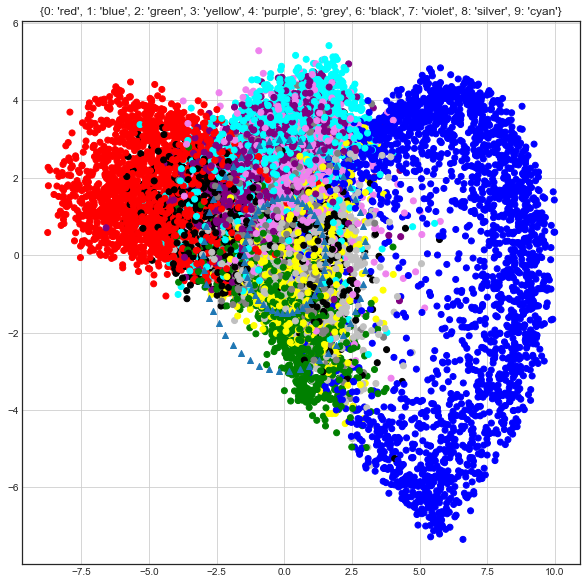

 iter: 56 batch: 19900 range: 1.3694637249767062e-07 recon cost: 0.1973365 zero cost: 0.5128357								 one  cost: 0.5470999 fake cost: 1.33624945956

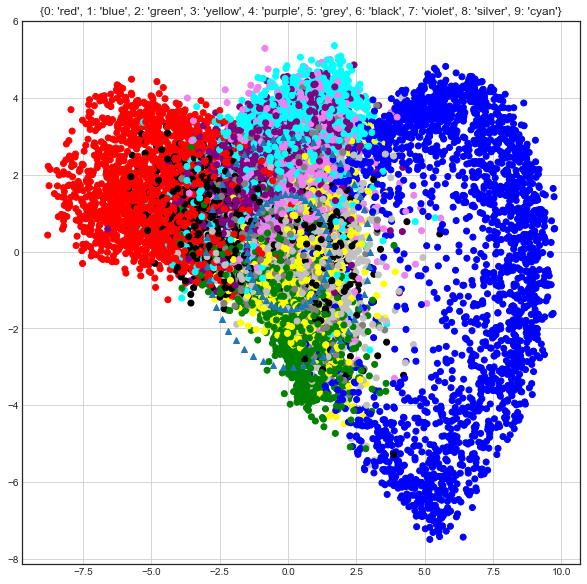

 iter: 57 batch: 19900 range: 1.2325173524790356e-07 recon cost: 0.19669905 zero cost: 0.5229536								 one  cost: 0.54853433 fake cost: 1.32043092

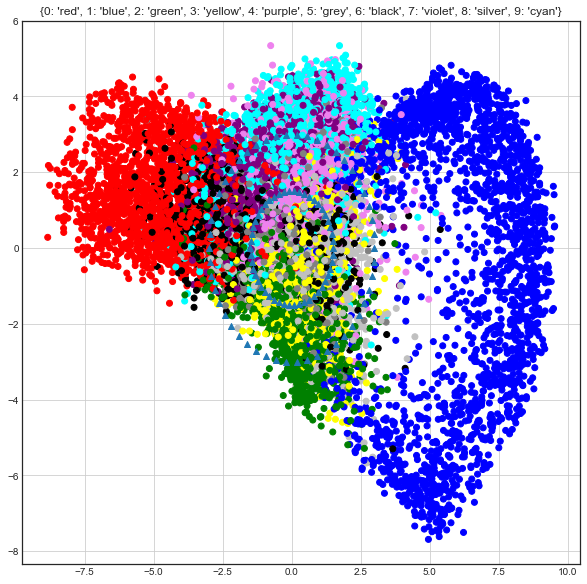

 iter: 58 batch: 19900 range: 1.109265617231132e-07 recon cost: 0.19605379 zero cost: 0.53480905								 one  cost: 0.54922557 fake cost: 1.30152133

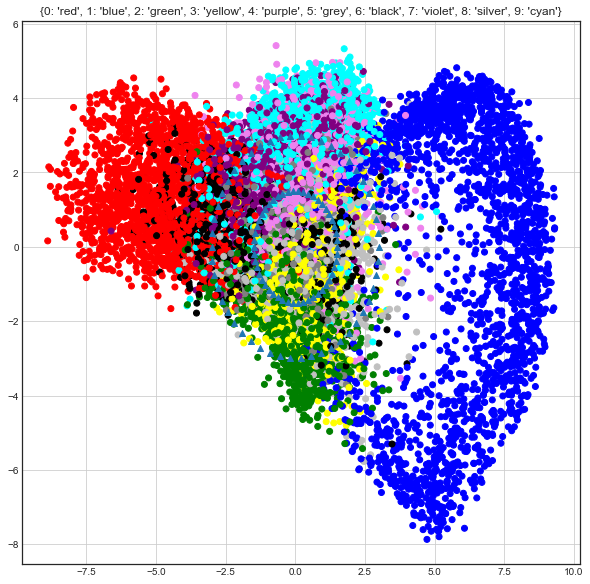

 iter: 59 batch: 19900 range: 9.983390555080188e-08 recon cost: 0.19541411 zero cost: 0.54598886								 one  cost: 0.5487272 fake cost: 1.29168272

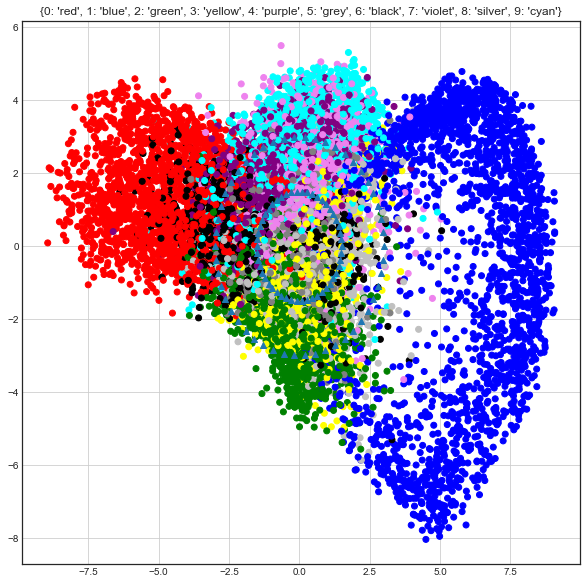

 iter: 60 batch: 19900 range: 8.985051499572169e-08 recon cost: 0.1948055 zero cost: 0.55949								 one  cost: 0.54632866 fake cost: 1.276178745876

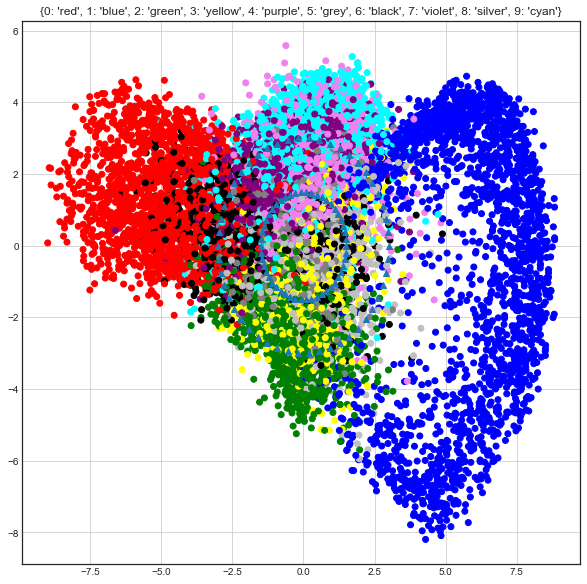

 iter: 61 batch: 19900 range: 8.086546349614952e-08 recon cost: 0.1942467 zero cost: 0.5679364								 one  cost: 0.541172 fake cost: 1.26042957531

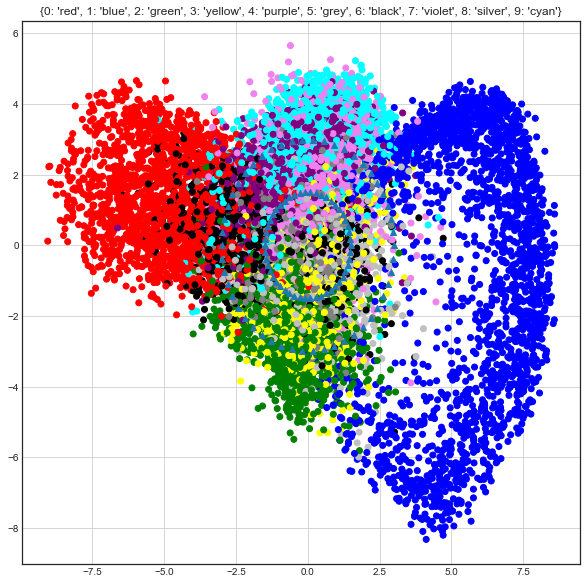

 iter: 62 batch: 19900 range: 7.277891714653458e-08 recon cost: 0.19375202 zero cost: 0.5731433								 one  cost: 0.5350951 fake cost: 1.249009866

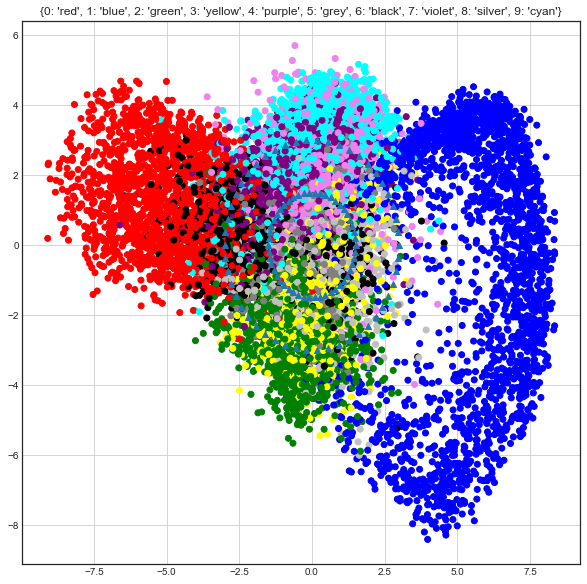

 iter: 63 batch: 19900 range: 6.550102543188112e-08 recon cost: 0.19331683 zero cost: 0.5773494								 one  cost: 0.52952135 fake cost: 1.237228226

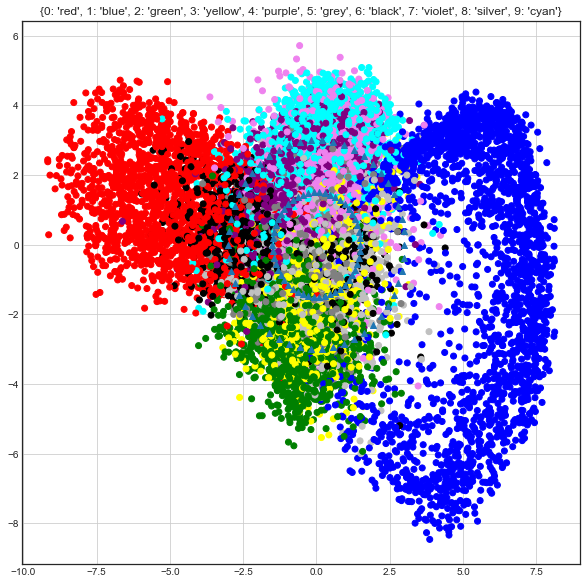

 iter: 64 batch: 19900 range: 5.895092288869301e-08 recon cost: 0.1929295 zero cost: 0.5840857								 one  cost: 0.52241796 fake cost: 1.223941626

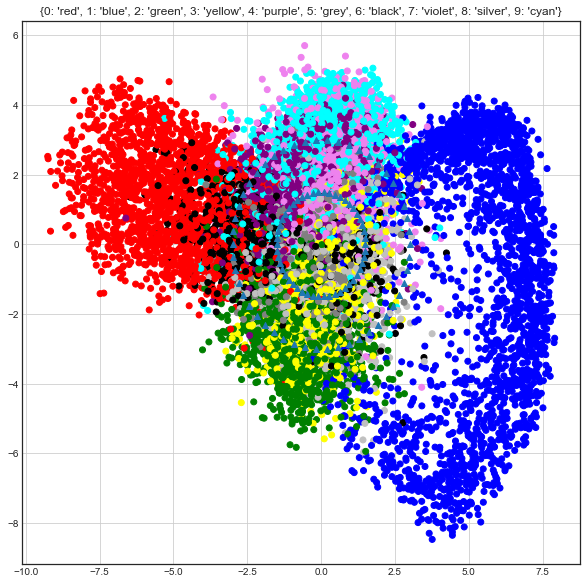

 iter: 65 batch: 19900 range: 5.305583059982371e-08 recon cost: 0.1925804 zero cost: 0.5906365								 one  cost: 0.51684654 fake cost: 1.214415401

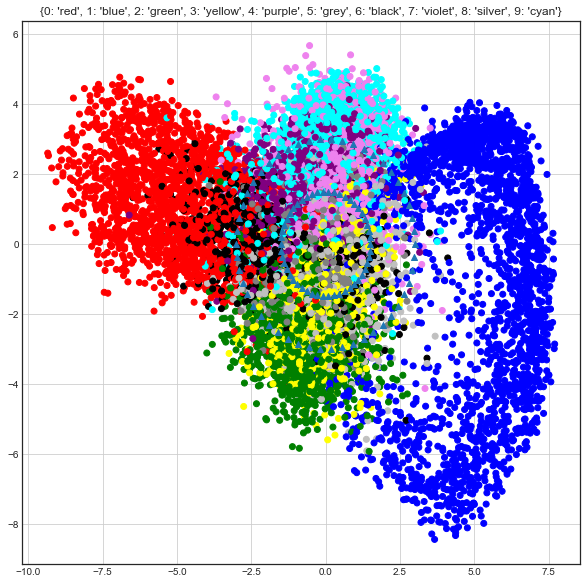

 iter: 66 batch: 19900 range: 4.775024753984134e-08 recon cost: 0.19226263 zero cost: 0.5980296								 one  cost: 0.51227427 fake cost: 1.20022816

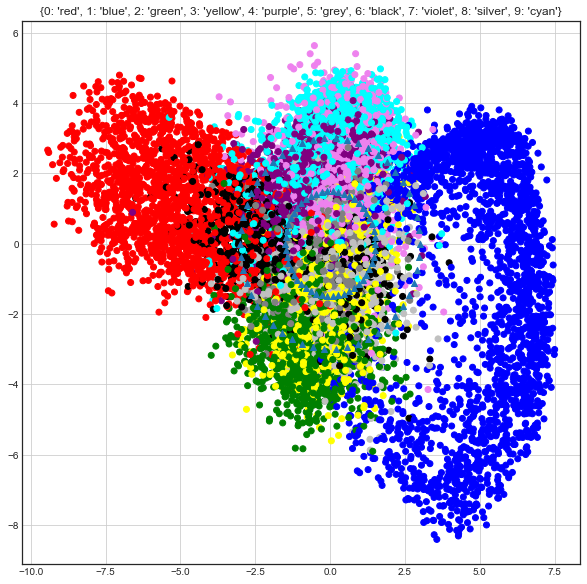

 iter: 67 batch: 19900 range: 4.297522278585721e-08 recon cost: 0.19197357 zero cost: 0.604067								 one  cost: 0.5083592 fake cost: 1.18971470887

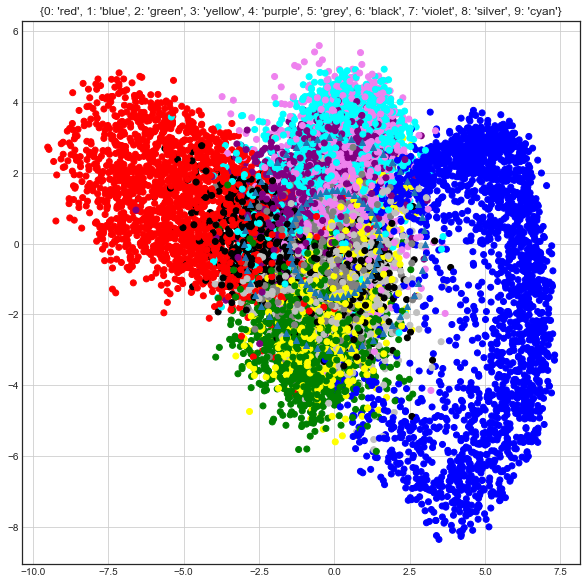

 iter: 68 batch: 19900 range: 3.867770050727149e-08 recon cost: 0.19170646 zero cost: 0.6106975								 one  cost: 0.50485486 fake cost: 1.17784266

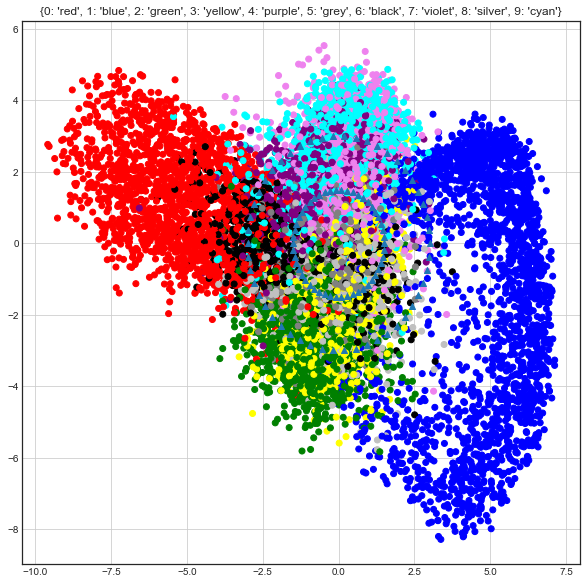

 iter: 69 batch: 19900 range: 3.480993045654434e-08 recon cost: 0.19145781 zero cost: 0.61670536								 one  cost: 0.502331 fake cost: 1.169980567

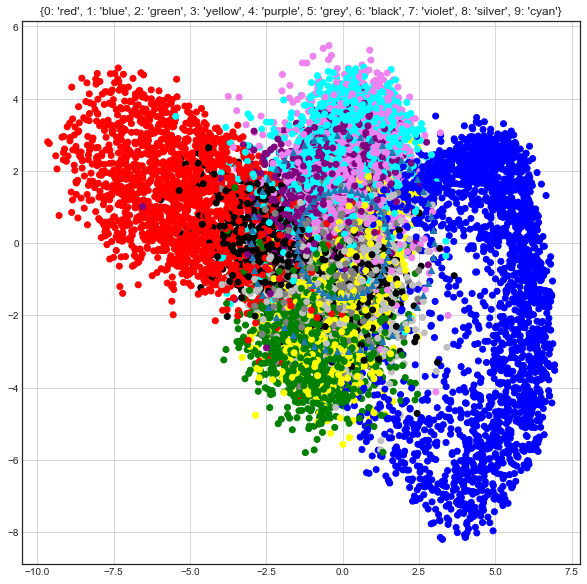

 iter: 70 batch: 19900 range: 3.132893741088991e-08 recon cost: 0.19122382 zero cost: 0.62350255								 one  cost: 0.4997053 fake cost: 1.16175078

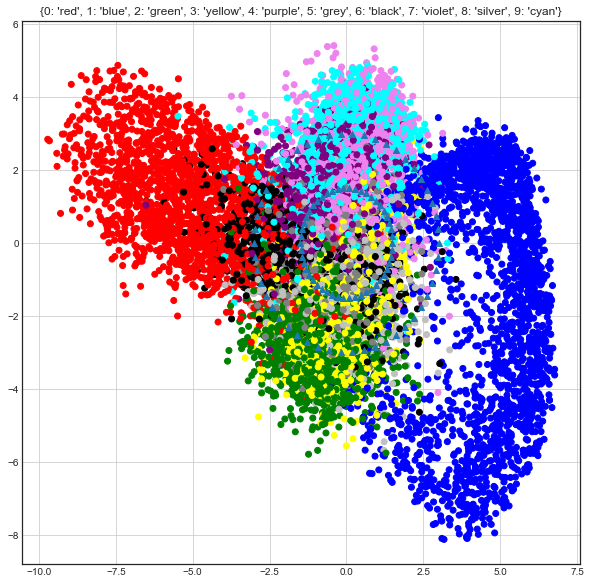

 iter: 71 batch: 19900 range: 2.8196043669800922e-08 recon cost: 0.19100219 zero cost: 0.63071114								 one  cost: 0.4969837 fake cost: 1.15607489

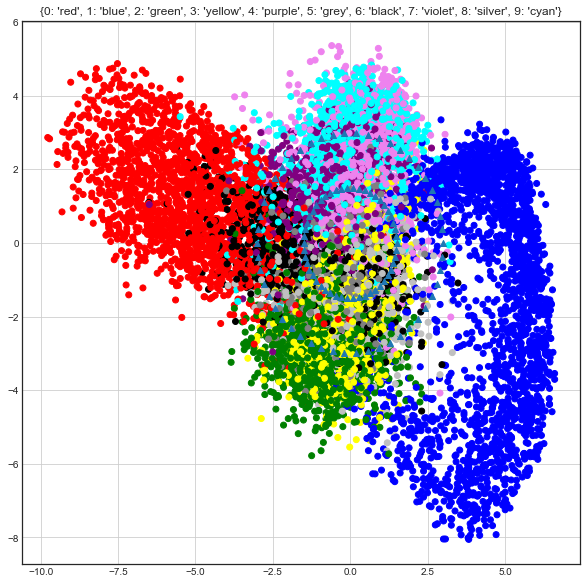

 iter: 72 batch: 19900 range: 2.537643930282083e-08 recon cost: 0.19079079 zero cost: 0.63807285								 one  cost: 0.4940971 fake cost: 1.14963876

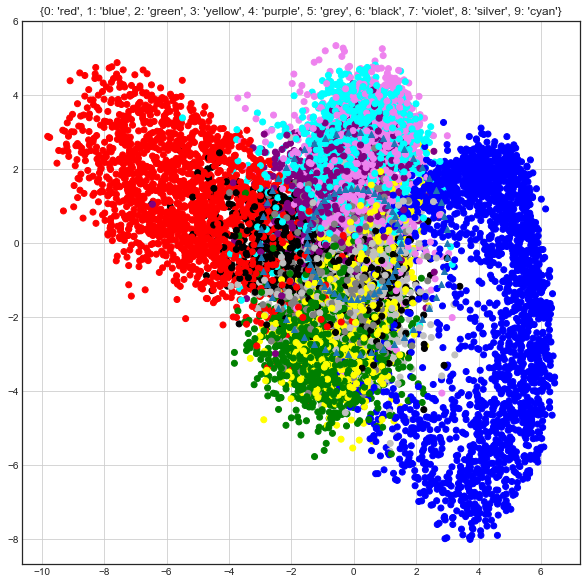

 iter: 73 batch: 19900 range: 2.2838795372538746e-08 recon cost: 0.19058701 zero cost: 0.6432255								 one  cost: 0.49167305 fake cost: 1.146658357

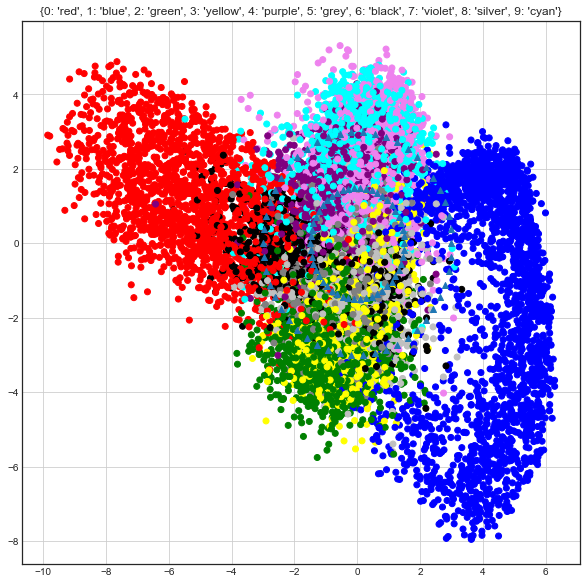

 iter: 74 batch: 19900 range: 2.0554915835284872e-08 recon cost: 0.19038641 zero cost: 0.6478764								 one  cost: 0.48915803 fake cost: 1.14357239

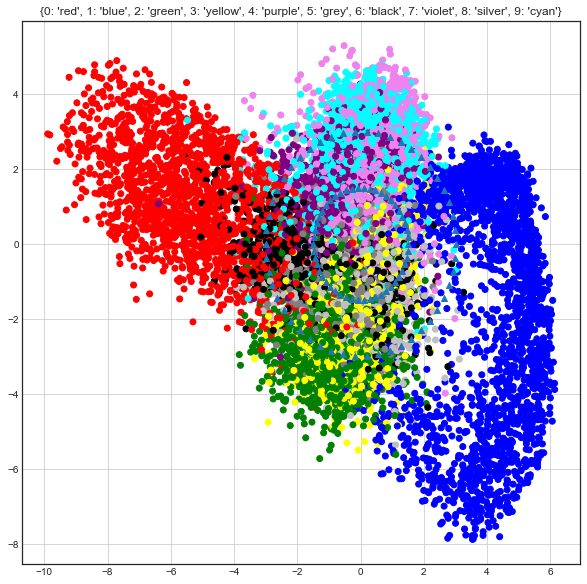

 iter: 75 batch: 19900 range: 1.8499424251756385e-08 recon cost: 0.19019143 zero cost: 0.652593								 one  cost: 0.48616204 fake cost: 1.138935728

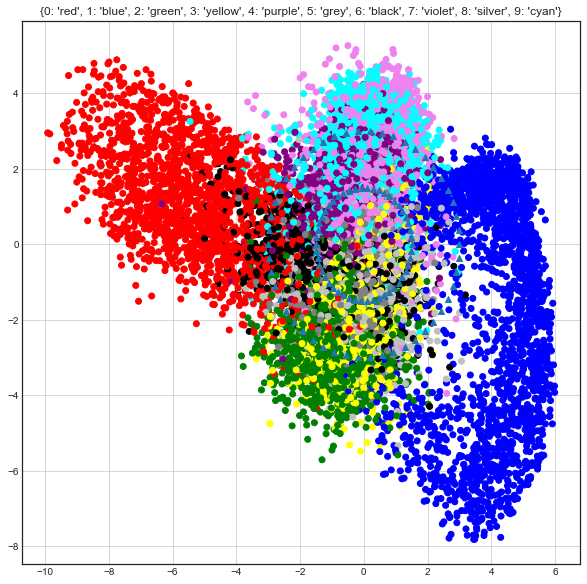

 iter: 76 batch: 19900 range: 1.6649481826580748e-08 recon cost: 0.18999906 zero cost: 0.65696853								 one  cost: 0.48326236 fake cost: 1.1367981

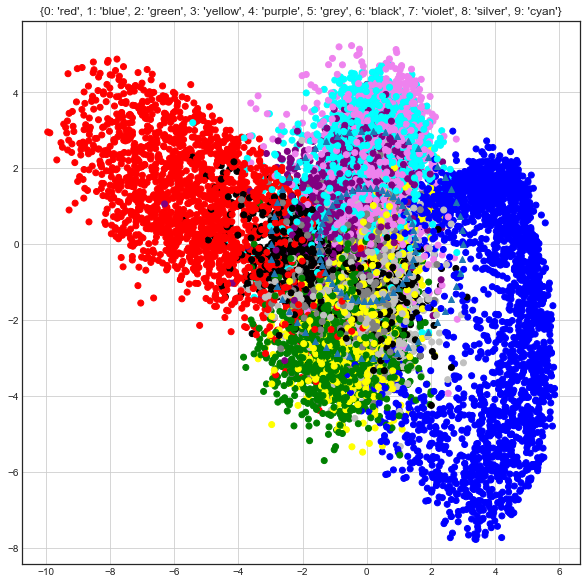

 iter: 77 batch: 19900 range: 1.4984533643922674e-08 recon cost: 0.18980806 zero cost: 0.6606944								 one  cost: 0.48019844 fake cost: 1.13550011

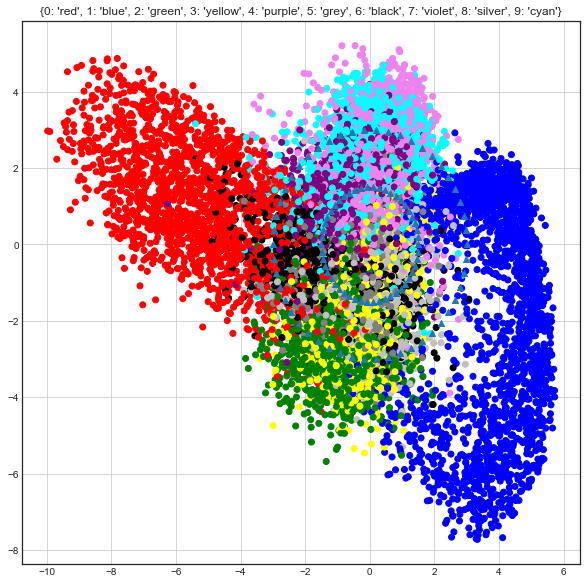

 iter: 78 batch: 19900 range: 1.3486080279530406e-08 recon cost: 0.18961585 zero cost: 0.6643212								 one  cost: 0.47725922 fake cost: 1.135829833

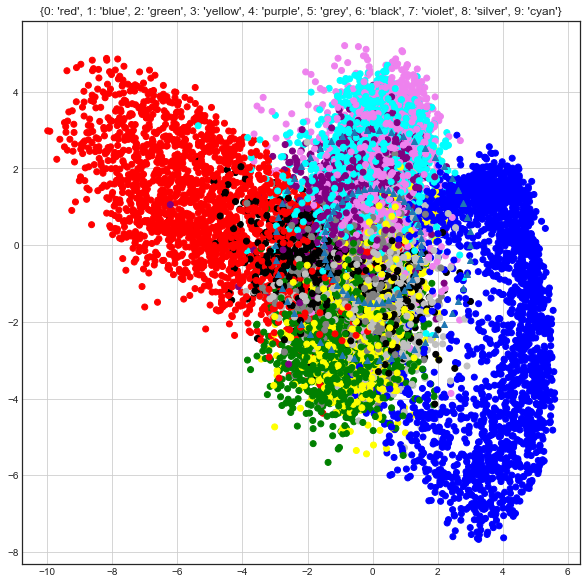

 iter: 79 batch: 19900 range: 1.2137472251577366e-08 recon cost: 0.18942338 zero cost: 0.66751254								 one  cost: 0.47393334 fake cost: 1.1368358

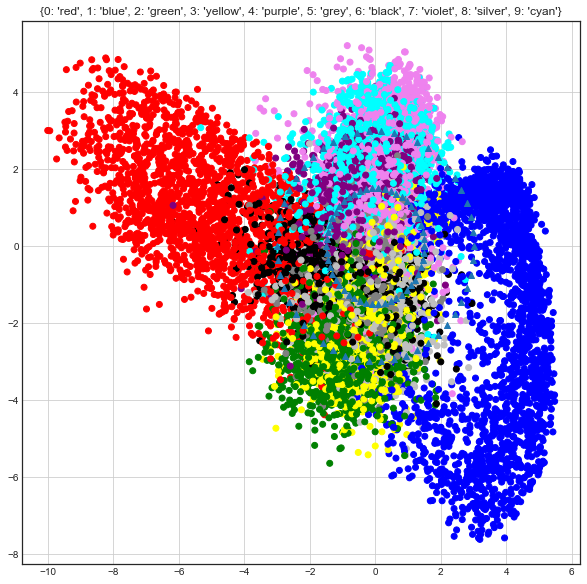

 iter: 80 batch: 19900 range: 1.092372502641963e-08 recon cost: 0.18923347 zero cost: 0.67080355								 one  cost: 0.4707375 fake cost: 1.13821352

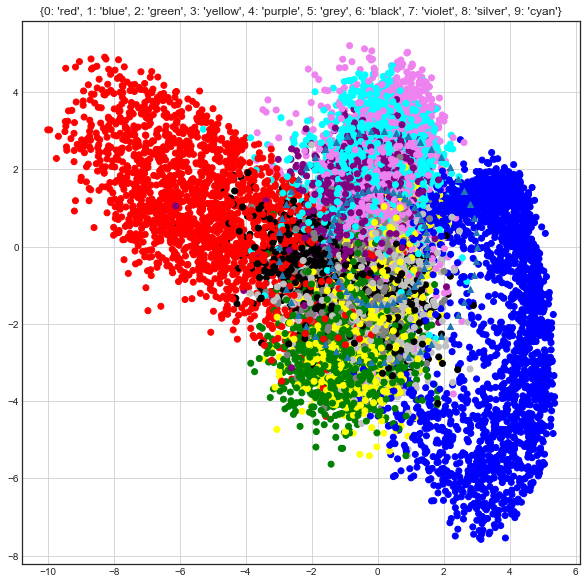

 iter: 81 batch: 19900 range: 9.831352523777668e-09 recon cost: 0.1890457 zero cost: 0.6740609								 one  cost: 0.46718627 fake cost: 1.139657946

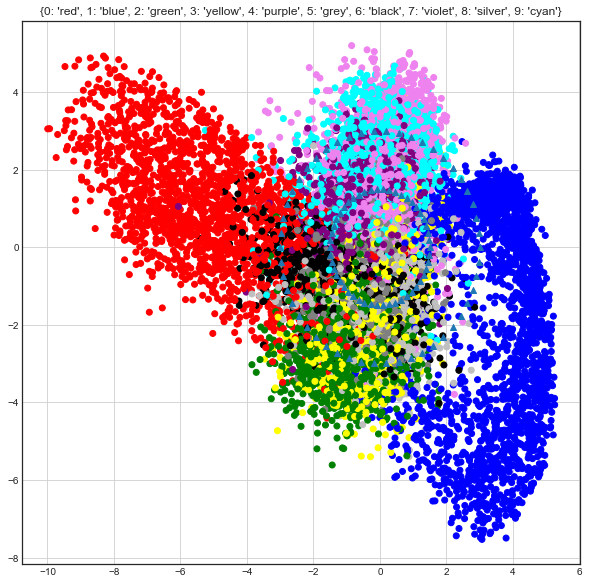

 iter: 82 batch: 19900 range: 8.848217271399902e-09 recon cost: 0.18886013 zero cost: 0.67714155								 one  cost: 0.46363652 fake cost: 1.1428262

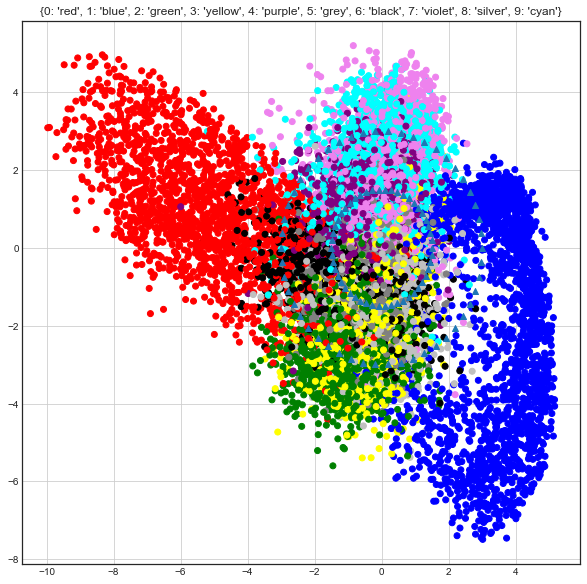

 iter: 83 batch: 19900 range: 7.963395544259912e-09 recon cost: 0.1886759 zero cost: 0.6792951								 one  cost: 0.45960796 fake cost: 1.149538424

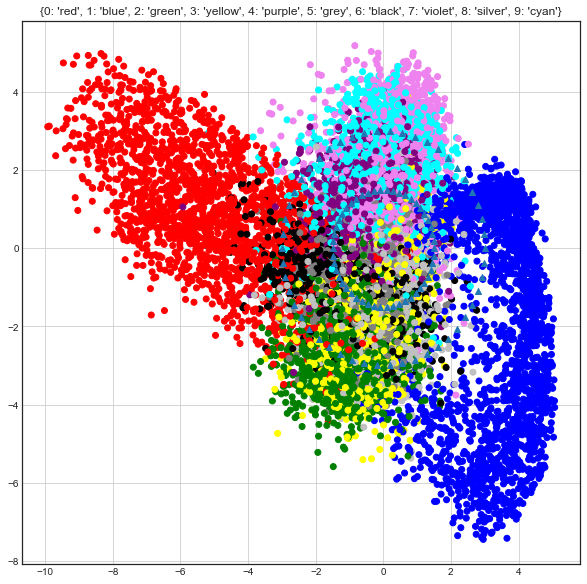

 iter: 84 batch: 19900 range: 7.167055989833921e-09 recon cost: 0.18849617 zero cost: 0.680552								 one  cost: 0.45528927 fake cost: 1.159962282

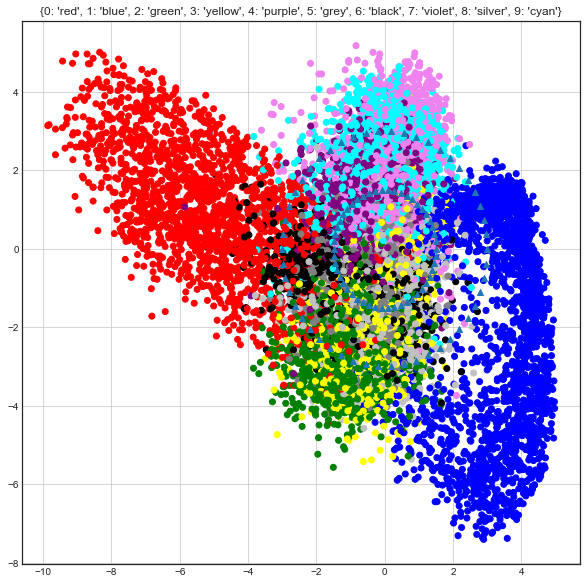

 iter: 85 batch: 19900 range: 6.450350390850529e-09 recon cost: 0.18831804 zero cost: 0.68181044								 one  cost: 0.45083296 fake cost: 1.1726391

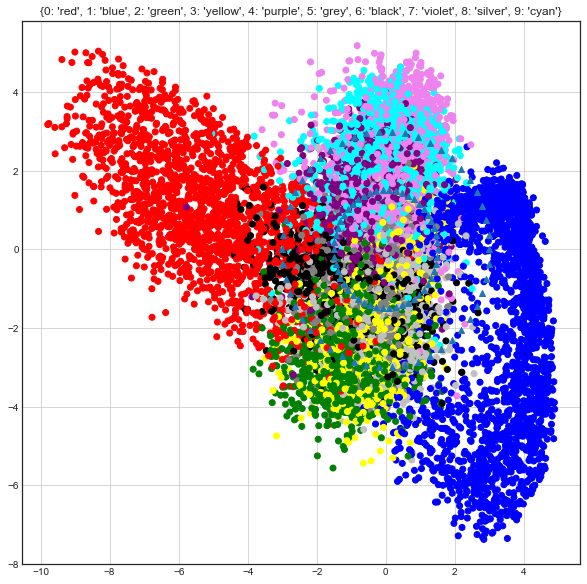

 iter: 86 batch: 19900 range: 5.805315351765476e-09 recon cost: 0.18814301 zero cost: 0.68244463								 one  cost: 0.44665518 fake cost: 1.18788646

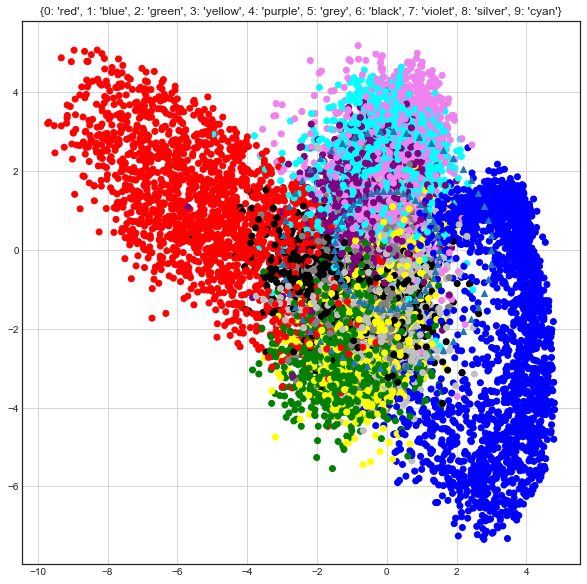

 iter: 87 batch: 19900 range: 5.224783816588928e-09 recon cost: 0.18796971 zero cost: 0.68283033								 one  cost: 0.4430986 fake cost: 1.20321644

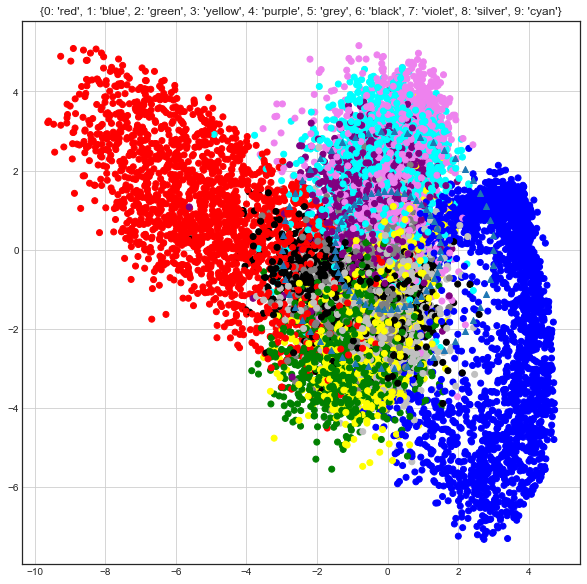

 iter: 88 batch: 19900 range: 4.702305434930035e-09 recon cost: 0.18780024 zero cost: 0.68298364								 one  cost: 0.43981346 fake cost: 1.2171542

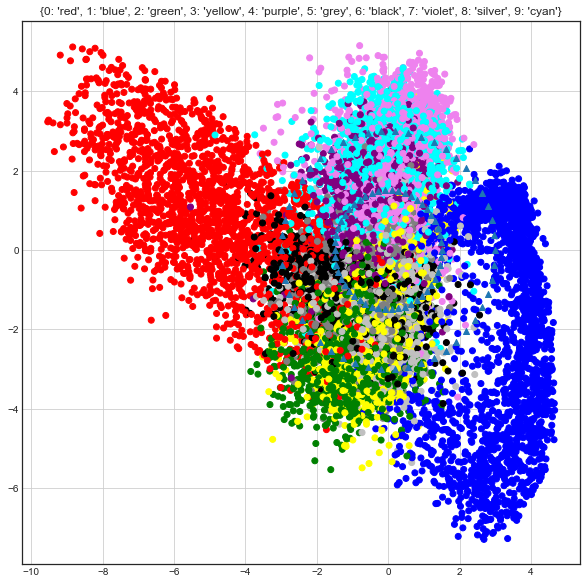

 iter: 89 batch: 19900 range: 4.2320748914370314e-09 recon cost: 0.1876343 zero cost: 0.6832956								 one  cost: 0.4371875 fake cost: 1.2297994703

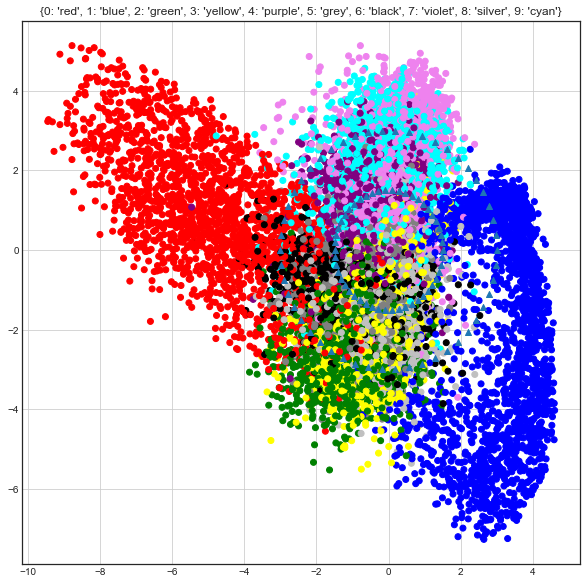

 iter: 90 batch: 19900 range: 3.808867402293329e-09 recon cost: 0.18747197 zero cost: 0.6842043								 one  cost: 0.4350199 fake cost: 1.241448253

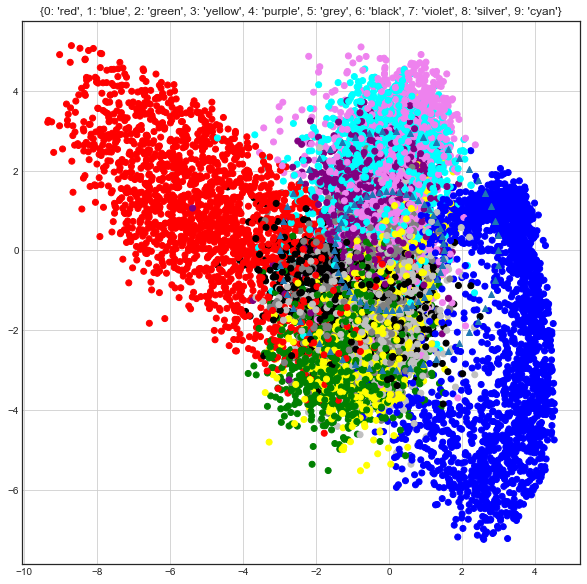

 iter: 91 batch: 19900 range: 3.427980662063996e-09 recon cost: 0.18731248 zero cost: 0.68567663								 one  cost: 0.43287063 fake cost: 1.2511946

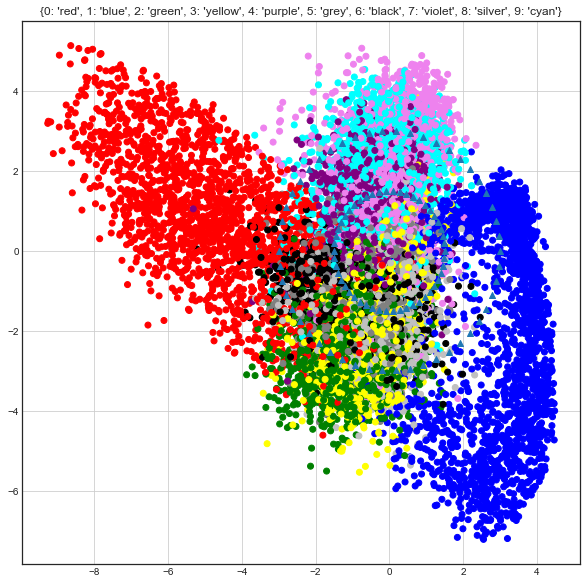

 iter: 92 batch: 19900 range: 3.0851825958575964e-09 recon cost: 0.18715318 zero cost: 0.6865894								 one  cost: 0.43082622 fake cost: 1.26013595

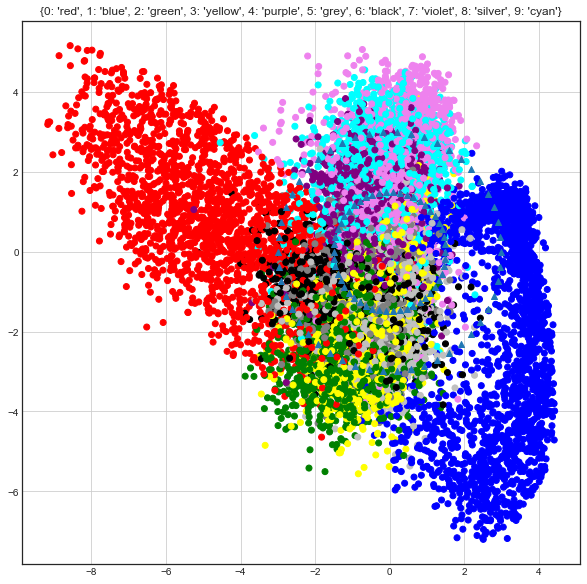

 iter: 93 batch: 19900 range: 2.7766643362718367e-09 recon cost: 0.18699627 zero cost: 0.68798286								 one  cost: 0.4291364 fake cost: 1.26739246

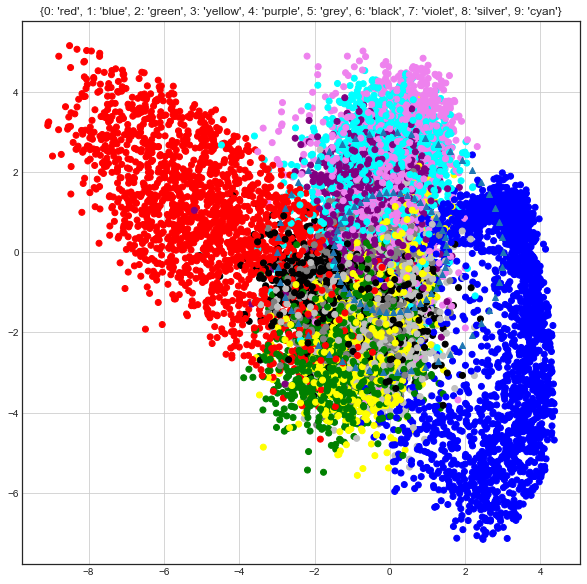

 iter: 94 batch: 19900 range: 2.498997902644653e-09 recon cost: 0.1868429 zero cost: 0.68961364								 one  cost: 0.42747256 fake cost: 1.27375196

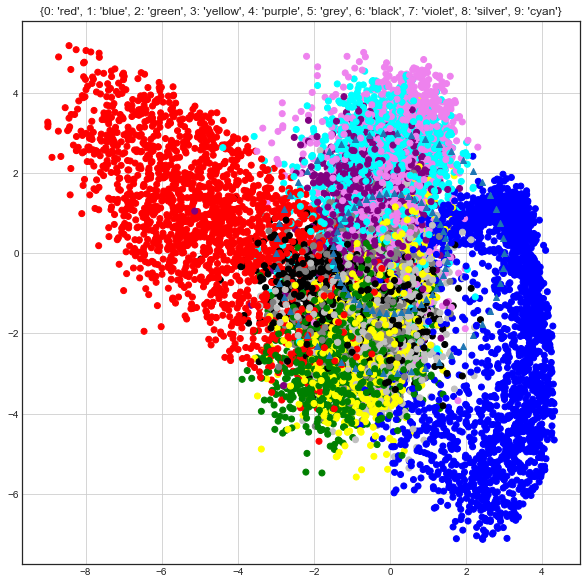

 iter: 95 batch: 19900 range: 2.249098112380188e-09 recon cost: 0.18668848 zero cost: 0.6909205								 one  cost: 0.42585343 fake cost: 1.27989426

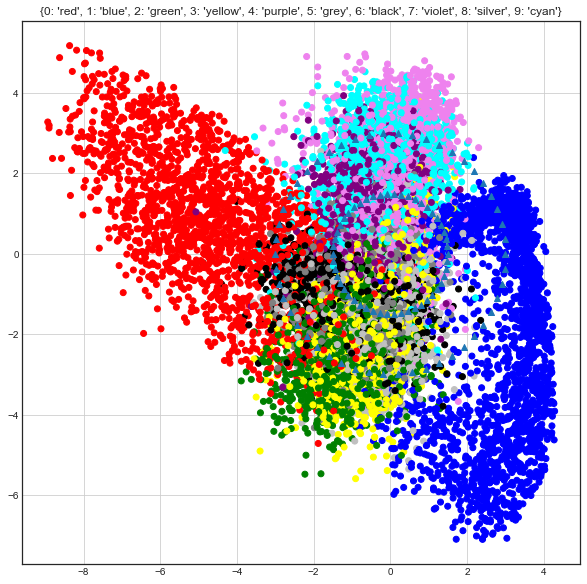

 iter: 96 batch: 19900 range: 2.024188301142169e-09 recon cost: 0.18653539 zero cost: 0.69162756								 one  cost: 0.4242667 fake cost: 1.28604782

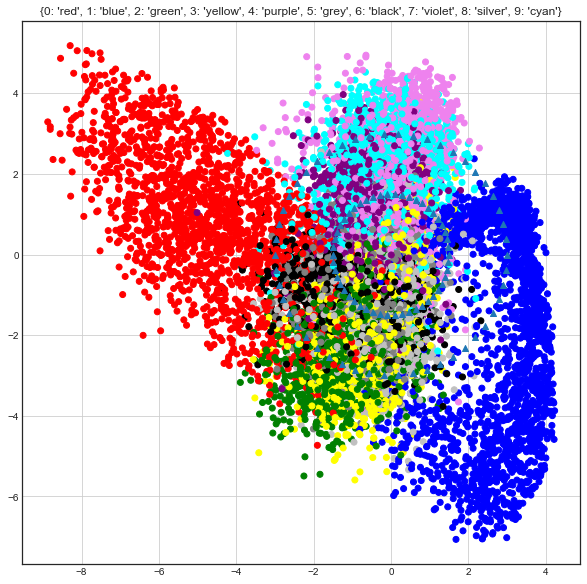

 iter: 97 batch: 19900 range: 1.8217694710279522e-09 recon cost: 0.1863803 zero cost: 0.69266707								 one  cost: 0.42287964 fake cost: 1.29115852

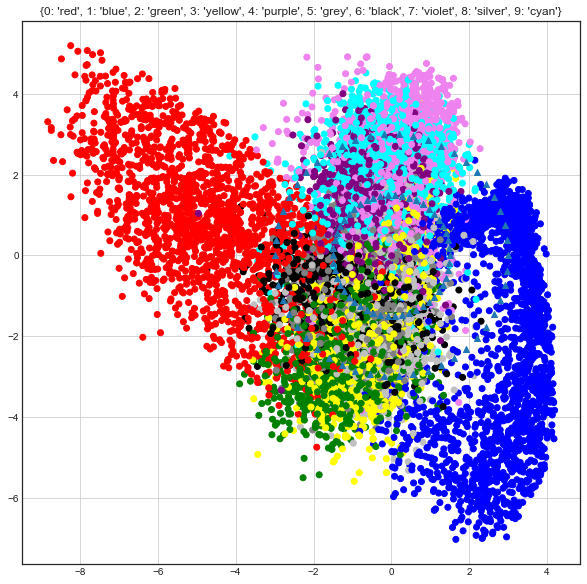

 iter: 98 batch: 19900 range: 1.639592523925157e-09 recon cost: 0.18622494 zero cost: 0.69417435								 one  cost: 0.42131463 fake cost: 1.2955531

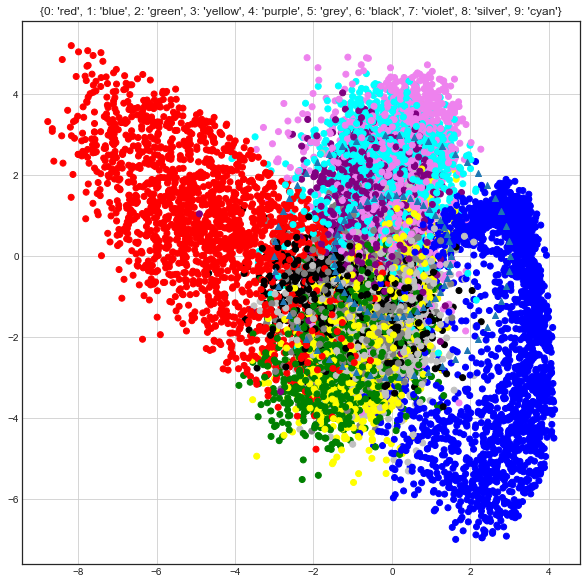

 iter: 99 batch: 19900 range: 1.4756332715326415e-09 recon cost: 0.18606965 zero cost: 0.6956375								 one  cost: 0.4200209 fake cost: 1.300066543

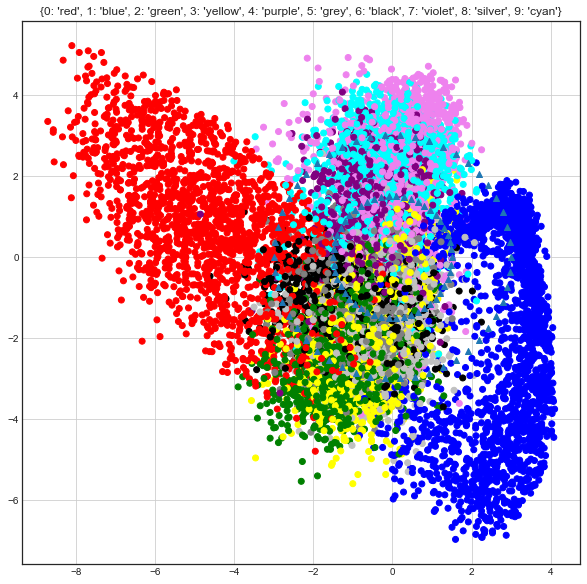

 iter: 100 batch: 19900 range: 1.3280699443793774e-09 recon cost: 0.18591294 zero cost: 0.69705576								 one  cost: 0.41875157 fake cost: 1.3046527

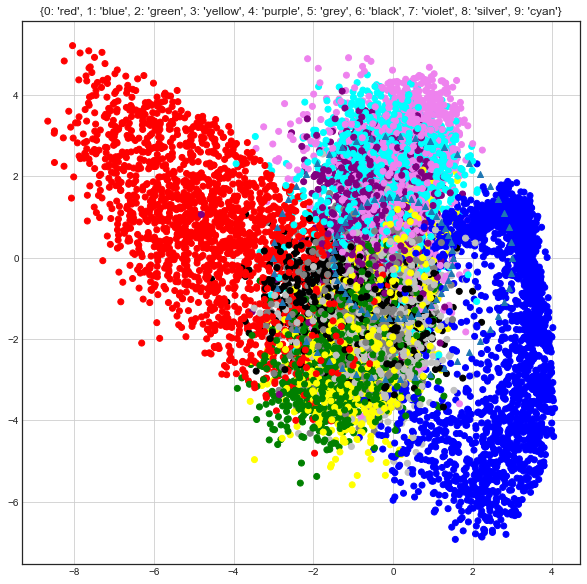

In [18]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets

#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.5)
        prior_z = prior_z * 3
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00002,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00002,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.9    
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-5,5);plt.ylim(-5,5);
        plt.grid();plt.show()

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()